In [1]:
import pandas as pd
from Bio import PDB
import os
import matplotlib.pyplot as plt
os.chdir('..')
from functions.myfunctions import *
from functions.sequencefunctions import get_vregion_seq_with_gaps
import functions.distancefunctions as df

In [2]:
structures_dir = '../data/structures/stcrdab_all_structures/imgt/'
datalist = pd.read_csv('data/tcrdbset_unique_receptors.csv', index_col=0).drop_duplicates(subset = ['pdb'], keep='first')
datalist1 = pd.read_csv('data/tcrdb_export_cleaned.csv', index_col=0).drop_duplicates(subset = ['pdb'], keep='first')

In [3]:
datalist

,alpha_aa_imgt_shorter,beta_aa_imgt_shorter,pdb,Bchain,Achain,model,antigen_chain,antigen_type,antigen_name,antigen_het_name,...,affinity,affinity_method,affinity_temperature,affinity_pmid,engineered,alpha_aa_imgt,alpha_aa_imgt_withGaps,beta_aa_imgt,beta_aa_imgt_withGaps,epitope_aa
0,AKTTQPDSMESTEGETVHLPCSHATISGNEYIYWYRQVPLQGPEYV...,AVTQSPRNKVTVTGGNVTLSCRQTNSHNYMYWYRQDTGHGLRLIHY...,['6l9l'],['H'],['G'],[0],['F'],['peptide'],['ser-pro-ser-tyr-ala-tyr-his-gln-phe'],['NA'],...,['NA'],['NA'],['NA'],['NA'],[True],['AKTTQPDSMESTEGETVHLPCSHATISGNEYIYWYRQVPLQGPE...,['-AKTTQ-PDSMESTEGETVHLPCSHATISG-----NEYIYWYRQ...,['AVTQSPRNKVTVTGGNVTLSCRQTNSHNYMYWYRQDTGHGLRLI...,['--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQ...,['SPSYAYHQF']
1,AKTTQPISMDSYEGQEVNITCNHNDIATSDYIMWYQQFPNQGPRFI...,DTAVSQTPKYLVRQTGKNESLKCEQNLGHNAMYWYKQDSKKLLKIM...,['7byd'],['J'],['I'],[0],['H'],['peptide'],['gly-gly-ala-ile'],['NA'],...,['NA'],['NA'],['NA'],['NA'],[True],['AKTTQPISMDSYEGQEVNITCNHNDIATSDYIMWYQQFPNQGPR...,['-AKTTQ-PISMDSYEGQEVNITCNHNDIAT-----SDYIMWYQQ...,['DTAVSQTPKYLVRQTGKNESLKCEQNLGHNAMYWYKQDSKKLLK...,['DTAVSQTPKYLVRQTGKNESLKCEQNLGH-------NAMYWYKQ...,['GGAI']
2,AKTTQPTSMDCAEGRAANLPCNHSTISGNEYVYWYRQIHSQGPQYI...,TGVSQNPRHKITKRGQNVTFRCDPISEHNRLYWYRQTLGQGPEFLT...,"['3dx9', '3dxa']","['D', 'E']","['C', 'D']","[0, 0]","['NA', 'C']","['NA', 'peptide']","['NA', 'ebv decapeptide epitope']","['NA', 'NA']",...,"['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","[True, True]",['AKTTQPTSMDCAEGRAANLPCNHSTISGNEYVYWYRQIHSQGPQ...,['-AKTTQ-PTSMDCAEGRAANLPCNHSTISG-----NEYVYWYRQ...,['TGVSQNPRHKITKRGQNVTFRCDPISEHNRLYWYRQTLGQGPEF...,['-TGVSQNPRHKITKRGQNVTFRCDPISEH-------NRLYWYRQ...,"['NA', 'EENLLDFVRF']"
3,AQEVTQIPAALSVPEGENLVLNCSFTDSAIYNLQWFRQDPGKGLTS...,NAGVTQTPKFQVLKTGQSMTLQCSQDMNHEYMSWYRQDPGMGLRLI...,"['6zkw', '6zkx']","['E', 'E']","['D', 'D']","[0, 0]","['C', 'C']","['peptide', 'peptide']",['enoyl-[acyl-carrier-protein] reductase [nadh...,"['NA', 'NA']",...,"['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","[True, True]",['AQEVTQIPAALSVPEGENLVLNCSFTDSAIYNLQWFRQDPGKGL...,['AQEVTQIPAALSVPEGENLVLNCSFTDSA------IYNLQWFRQ...,['NAGVTQTPKFQVLKTGQSMTLQCSQDMNHEYMSWYRQDPGMGLR...,['NAGVTQTPKFQVLKTGQSMTLQCSQDMNH-------EYMSWYRQ...,"['RLPAKAPLL', 'RLPAKAPLLGCG']"
4,AQEVTQIPAALSVPEGENLVLNCSFTDSAIYNLQWFRQDPGKGLTS...,AGVTQTPRYLIKTRGQQVTLSCSPISGHRSVSWYQQTPGQGLQFLF...,"['5brz', '5bs0']","['E', 'E']","['D', 'D']","[0, 0]","['C', 'C']","['peptide', 'peptide']","['glu-val-asp-pro-ile-gly-his-leu-tyr', 'titin']","['NA', 'NA']",...,"['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","['NA', 'NA']","[True, True]",['AQEVTQIPAALSVPEGENLVLNCSFTDSAIYNLQWFRQDPGKGL...,['AQEVTQIPAALSVPEGENLVLNCSFTDSA------IYNLQWFRQ...,['AGVTQTPRYLIKTRGQQVTLSCSPISGHRSVSWYQQTPGQGLQF...,['-AGVTQTPRYLIKTRGQQVTLSCSPISGH-------RSVSWYQQ...,"['EVDPIGHLY', 'ESDPIVAQY']"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
209,SQQGEEDPQALSIQEGENATMNCSYKTSINNLQWYRQNSGRGLVHL...,NAGVTQTPKFRVLKTGQSMTLLCAQDMNHEYMYWYRQDPGMGLRLI...,['7t2b'],['E'],['D'],[0],['C'],['peptide'],['pneumolysin-derived peptide'],['NA'],...,['NA'],['NA'],['NA'],['NA'],[True],['SQQGEEDPQALSIQEGENATMNCSYKTSINNLQWYRQNSGRGLV...,['SQQGEEDPQALSIQEGENATMNCSYKTSI-------NNLQWYRQ...,['NAGVTQTPKFRVLKTGQSMTLLCAQDMNHEYMYWYRQDPGMGLR...,['NAGVTQTPKFRVLKTGQSMTLLCAQDMNH-------EYMYWYRQ...,['GATGLAWEWWRTVYE']
210,SQQGEEDPQALSIQEGENATMNCSYKTSINNLQWYRQNSGRGLVHL...,GAVVSQHPSWVISKSGTSVKIECRSLDFQATTMFWYRQFPKQSLML...,['1ymm'],['E'],['D'],[0],['C'],['peptide'],['mbp peptide'],['NA'],...,['NA'],['NA'],['NA'],['NA'],[True],['SQQGEEDPQALSIQEGENATMNCSYKTSINNLQWYRQNSGRGLV...,['SQQGEEDPQALSIQEGENATMNCSYKTSI-------NNLQWYRQ...,['GAVVSQHPSWVISKSGTSVKIECRSLDFQATTMFWYRQFPKQSL...,['GAVVSQHPSWVISKSGTSVKIECRSLDFQ------ATTMFWYRQ...,['ENPVVHFFKNIVTP']
211,SVTQPDARVTVSEGASLQLRCKYSYSATPYLFWYVQYPRQGPQLLL...,AAVTQSPRNKVAVTGEKVTLSCNQTNNHNNMYWYRQDTGHELRLIY...,['3e3q'],['a'],['Z'],[0],['b'],['peptide'],['unknown'],['NA'],...,['NA'],['NA'],['NA'],['NA'],[True],['SVT

In [4]:
from Levenshtein import distance as lev

datalist['alpha_aa_imgt_shorter_withgaps'] = [get_vregion_seq_with_gaps(x) for x in datalist['alpha_aa_imgt_shorter']]
datalist['beta_aa_imgt_shorter_withgaps'] = [get_vregion_seq_with_gaps(x) for x in datalist['beta_aa_imgt_shorter']]
print(max(len(x) for x in datalist['alpha_aa_imgt_shorter_withgaps']), min(len(x) for x in datalist['alpha_aa_imgt_shorter_withgaps']))
print(max(len(x) for x in datalist['beta_aa_imgt_shorter_withgaps']), min(len(x) for x in datalist['beta_aa_imgt_shorter_withgaps']))

131 127
132 126


['6l9l'] ['6l9l']
--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQDTGHGLRLIHYSYG----AGNLQIGDVP-DGYKATRT-TQEDFFLLLELASPSQTSLYFCASSDG--------DYEQYFGPGTRLTVL
--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQDTGHGLRLIHYSYG----AGNLQIGDVP-DGYKATRT-TQEDFFLLLELASPSQTSLYFCASSDG--------DYEQYFGPGTRLTVL
['6l9l'] ['7byd']
--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQDTGHGLRLIHYSYG----AGNLQIGDVP-DGYKATRT-TQEDFFLLLELASPSQTSLYFCASSDG--------DYEQYFGPGTRLTVL
DTAVSQTPKYLVRQTGKNESLKCEQNLGH-------NAMYWYKQDSKKLLKIMFIYNN----KEPILNETVP-YRFSPKSP-DKAHLNLHIKSLELGDSAVYFCASSQDL---GAGEVYEQYFGPGTRLTVI
['6l9l'] ['3dx9', '3dxa']
--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQDTGHGLRLIHYSYG----AGNLQIGDVP-DGYKATRT-TQEDFFLLLELASPSQTSLYFCASSDG--------DYEQYFGPGTRLTVL
-TGVSQNPRHKITKRGQNVTFRCDPISEH-------NRLYWYRQTLGQGPEFLTYFQN----EAQLEKSRLLSDRFSAERP-KGSFSTLEIQRTEQGDSAMYLCASRYRD-----DSYNEQFFGPGTRLTVL
['6l9l'] ['6zkw', '6zkx']
--AVTQSPRNKVTVTGGNVTLSCRQTNSH-------NYMYWYRQDTGHGLRLIHYSYG----AGNLQIGDVP-DGYKATRT-TQEDFFLLLELASPSQTSLYFCASSDG-----

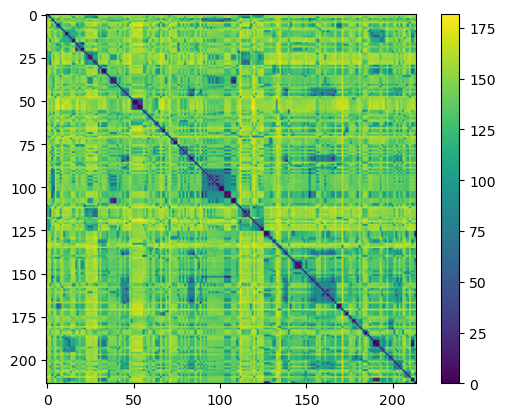

[1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.5, 1.0, 1.0, 0.5, 0.5, 0.3333333333333333, 1.0, 1.0, 0.3333333333333333, 0.3333333333333333, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 1.0, 1.0, 1.0, 1.0, 0.25, 1.0, 1.0, 1.0, 1.0, 0.3333333333333333, 1.0, 1.0, 1.0, 1.0, 1.0, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.5, 0.3333333333333333, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.5, 1.0, 1.0, 1.0, 0.5, 1.0, 0.5, 1.0, 0.5, 0.5, 0.3333333333333333, 1.0, 1.0, 1.0, 0.5, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 1.0, 0.5, 1.0, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 0.25, 0.3333333333333333, 0.5, 0.3333333333333333, 0.25, 0.25, 0.25, 1.0, 0.5, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 0.5, 0.5, 0.3333333333333333, 0.3333333333333333, 0.3333333333333333, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0, 1.0,

In [5]:

alpha_dists = np.empty(shape = (datalist.shape[0], datalist.shape[0]))
beta_dists = np.empty(shape = (datalist.shape[0], datalist.shape[0]))

max_len_a = max(len(x) for x in datalist['alpha_aa_imgt_shorter_withgaps'])
max_len_b = max(len(x) for x in datalist['beta_aa_imgt_shorter_withgaps'])

for i in range(datalist.shape[0]):
    for j in range(datalist.shape[0]):
        pdbx = datalist.iloc[i]['pdb']
        pdby = datalist.iloc[j]['pdb']
        xa = datalist.iloc[i]['alpha_aa_imgt_shorter_withgaps']
        ya = datalist.iloc[j]['alpha_aa_imgt_shorter_withgaps']
        if pdbx == '[\'7jwj\']':
            xa = ''.join(list(xa)[1:])
        if pdby == '[\'7jwj\']':
            ya = ''.join(list(ya)[1:])
        if pdbx != '[\'3vxt\', \'3vxu\', \'3w0w\']':
            assert xa[103] == 'C'
        else:
            assert xa[103] == 'W'
        if pdby != '[\'3vxt\', \'3vxu\', \'3w0w\']':
            assert ya[103] == 'C'
        else:
            assert ya[103] == 'W'
        
        if len(xa) < max_len_a:
            xa = list(xa)
            xa = ''.join(xa[:110] + ['-']*(max_len_a-len(xa)) + xa[110:])
        if len(ya) < max_len_a:
            ya = list(ya)
            ya = ''.join(ya[:110] + ['-']*(max_len_a-len(ya)) + ya[110:])

        if pdbx != '[\'3vxt\', \'3vxu\', \'3w0w\']':
            assert xa[103] == 'C'
        else:
            assert xa[103] == 'W'
        if pdby != '[\'3vxt\', \'3vxu\', \'3w0w\']':
            assert ya[103] == 'C'
        else:
            assert ya[103] == 'W'
        
        assert len(xa) == len(ya)
        
        xb = datalist.iloc[i]['beta_aa_imgt_shorter_withgaps']
        yb = datalist.iloc[j]['beta_aa_imgt_shorter_withgaps']

        assert xb[103] == 'C'
        assert yb[103] == 'C'

        if len(xb) < max_len_b:
            xb = list(xb)
            xb = ''.join(xb[:110] + ['-']*(max_len_b-len(xb)) + xb[110:])
        if len(yb) < max_len_b:
            yb = list(yb)
            yb = ''.join(yb[:110] + ['-']*(max_len_b-len(yb)) + yb[110:])
        assert xb[103] == 'C'
        assert yb[103] == 'C'
        print(pdbx, pdby)
        print(xb)
        print(yb)
        assert len(xb) == len(yb)

        alpha_dists[i,j] = lev(xa, ya)
        beta_dists[i,j] = lev(xb,yb)

print(alpha_dists)
print(beta_dists)

ab_dists = alpha_dists + beta_dists
plt.imshow(ab_dists)
plt.colorbar()
plt.show()

weigth_vector = [1/np.sum(ab_dists[i] < 11) for i in range(ab_dists.shape[0])]
print(weigth_vector)
print(sum(weigth_vector))

In [6]:
p = PDB.PDBParser()

distances_a = {}
distances_b = {}

for pdb in list(datalist.pdb):
    for ppdb in pdb.split(','):
        ppdb = ppdb.strip('[]\' ')
        s = ppdb + '.pdb'
        print(ppdb)

        struc = p.get_structure(ppdb, structures_dir + s)
        achain = list(datalist1.loc[datalist1.pdb == ppdb]['Achain'])[0]
        bchain = list(datalist1.loc[datalist1.pdb == ppdb]['Bchain'])[0]

        da = df.CA_pairwise_distances(struc[0][achain],struc[0][achain])
        db = df.CA_pairwise_distances(struc[0][bchain],struc[0][bchain])
        distances_a[ppdb] = da
        distances_b[ppdb] = db

6l9l
7byd
3dx9
3dxa
6zkw
6zkx
5brz
5bs0
4wnq
7ow5
7ow6
7pb2
7t2d
6rpa
6vm7
6vm8
6fra
6eh6
6eh7
6fr9
6frb
6frc
6fum
6fun
6fuo
6fup
6fuq
6fur
3tfk
3tjh
3tpu
4ms8
4mvb
4mxq
4n0c
4n5e
3vxm
8gvb
8gvg
8gvi
5yxu
6vrn
6p64
6uk2
6uk4
5yxn
5jzi
7n5c
5d2n
4gg6
4gg8
4z7u
4z7v
7dzm
7dzn
5wjo
6rsy
3rgv
1nfd
2pxy
2z31
2z35
5d7k
4mji
5ks9
5ksb
4prh
4pri
5ksa
2ypl
4jry
3utp
3uts
3utt
5c07
5c08
5c09
5c0a
5c0b
5c0c
5hyj
3qdg
3qdj
3qeu
6am5
6amu
3hg1
4qok
6eqa
7q99
7q9a
4zdh
6uz1
3o4l
7jwj
4p2o
3qib
3qjf
4p2q
4p2r
3qjh
3qiu
3qiw
4qrp
1zgl
7nme
7nmf
7nmg
6ovo
5tez
7z50
6r2l
3mbe
6mra
6cuh
4dzb
4g8e
4g8f
5w1v
5w1w
5e6i
7sg1
6vmx
5d2l
6cqn
6cph
6cql
6cqq
6cqr
5jhd
2ial
2iam
2ian
4e41
4e42
5men
4udt
4mnq
5nmd
5nme
5nmf
5nmg
1ao7
1qrn
1qse
1qsf
2gj6
3h9s
3pwp
3qfj
3qh3
7amp
7amq
7amr
7ams
4ftv
4grm
4l3e
6d78
3ffc
4g8g
4g9f
6tro
4jfd
4jff
6tmo
2f53
4ww1
7r7z
7r80
6px6
7n2n
7n2o
5eu6
8cx4
3vxq
3vxr
3vxs
7n2s
7n2p
7n2q
7n2r
6fr3
6fr4
6eh5
6fr5
6eh4
2pye
2pyf
2p5e
2f54
2p5w
3mv9
3mv8
3mv7
4prp
2q86
3pqy
7n5p
4ozi


In [7]:
def sort_distance_df(d2):
    res_numbers = list(range(1, 85)) + ['84A'] + list(range(85, 112)) + ['111A', '111B',
                    '111C', '111D', '111E', '111F', '112F', '112E', '112D', '112C', '112B', '112A', '112'] + list(range(113, 400))
    res_numbers_v = list(range(1, 85)) + ['84A'] + list(range(85, 112)) + ['111A', '111B',
                        '111C', '111D', '111E', '111F', '112F', '112E', '112D', '112C', '112B', '112A', '112'] + list(range(113, 131))
    rule = {
     str(x):i for i, x in enumerate(res_numbers)
    }

    d2['C'] = [rule[x] for x in d2.index.values]
    d2 = d2.sort_values(by=['C']).drop(['C'], axis = 1)

    d3 = d2.T
    d3['C'] = [rule[x] for x in d3.index.values]
    d3 = d3.sort_values(by=['C']).drop(['C'], axis = 1)
    d4 = d3.T
    d4_vreg = d4.loc[d4.index.isin([str(x) for x in res_numbers_v])]
    d4_vreg = d4_vreg.T.loc[d4_vreg.columns.isin([str(x) for x in res_numbers_v])].T
    return(d4_vreg)


In [8]:
import seaborn as sns
import matplotlib.pyplot as plt

In [9]:
def plot_heatmap(mydf, save='no', myoutput=None, cmap = 'rocket', vmin=3, vmax=20, clabel = r'C$\alpha$-C$\alpha$ distance ($\AA$)'):
     c = (save.lower() == 'no') or (save.lower() == 'yes')
     # print(c)
     assert c, 'ERROR: save must be one of yes or no'

     il1 = np.triu_indices(mydf.shape[0])
     xx = np.array(mydf)
     xx[il1] = np.nan
     mydf1 = pd.DataFrame(xx, columns=mydf.columns, index=mydf.index)

     fig, ax = plt.subplots(figsize=(13,16))
     myax = sns.heatmap(mydf1, vmax = vmax, vmin = vmin, cmap=cmap, 
                        cbar_kws = {'orientation':'horizontal', 'pad':0.1, 'fraction':0.1})
     cbar = myax.collections[0].colorbar
     cbar.ax.tick_params(labelsize=18)
     cbar.set_label(clabel, fontsize= 24)

     x1_1 = list(mydf.columns.astype(str).values).index('26') + 0.5
     x1_2 = list(mydf.columns.astype(str).values).index('39') + 0.5
     y1_1 = list(mydf.index.astype(str).values).index('26') + 0.5
     y1_2 = list(mydf.index.astype(str).values).index('39') + 0.5

     y2_1 = list(mydf.index.astype(str).values).index('55') + 0.5
     y2_2 = list(mydf.index.astype(str).values).index('66') + 0.5
     x2_1 = list(mydf.columns.astype(str).values).index('55') + 0.5
     x2_2 = list(mydf.columns.astype(str).values).index('66') + 0.5

     x3_1 = list(mydf.columns.astype(str).values).index('104') + 0.5
     x3_2 = list(mydf.columns.astype(str).values).index('118') + 0.5
     y3_1 = list(mydf.index.astype(str).values).index('104') + 0.5
     y3_2 = list(mydf.index.astype(str).values).index('118') + 0.5

     ymax =  len(mydf.index)
     xmax =  mydf.columns.max()
     print(ymax)
     ax.vlines(x1_1, ymin=y1_1, ymax =ymax, lw=3, color='cyan')
     ax.vlines(x1_2, ymin=y1_2, ymax =ymax, lw=3, color='cyan')
     ax.vlines(x2_1, ymin=y2_1, ymax =ymax, lw=3, color='teal')
     ax.vlines(x2_2, ymin=y2_2, ymax =ymax, lw=3, color='teal')
     ax.vlines(x3_1, ymin=y3_1, ymax =ymax, lw=3, color='mediumpurple')
     ax.vlines(x3_2, ymin=y3_2, ymax =ymax, lw=3, color='mediumpurple')

     ax.hlines(y1_1, xmin=x1_1, xmax =xmax, lw=3, color='cyan')
     ax.hlines(y1_2, xmin=x1_2, xmax =xmax, lw=3, color='cyan')
     ax.hlines(y2_1, xmin=x2_1, xmax =xmax, lw=3, color='teal')
     ax.hlines(y2_2, xmin=x2_2, xmax =xmax, lw=3, color='teal')
     ax.hlines(y3_1, xmin=x3_1, xmax =xmax, lw=3, color='mediumpurple')
     ax.hlines(y3_2, xmin=x3_2, xmax =xmax, lw=3, color='mediumpurple')

     plt.yticks(fontsize=17)
     plt.xticks(rotation=90, fontsize=17)

     plt.text(y = (y1_1 + y1_2)/2, x=x1_1+4, s = 'CDR1', fontsize = 30, 
               verticalalignment = 'center', weight = 'bold', color='cyan')
     plt.text(y = (y2_1 + y2_2)/2, x=x2_1+4, s = 'CDR2', fontsize = 30, 
               verticalalignment = 'center', weight = 'bold', color='teal')
     plt.text(y = (y3_1 + y3_2)/2, x=x3_1+6, s = 'CDR3', fontsize = 30, 
               verticalalignment = 'center', weight = 'bold', color='mediumpurple')

     plt.tight_layout()

     if save == 'yes':
          assert myoutput, 'ERROR: please assign output folder and name'
          plt.savefig(myoutput, format = 'png', bbox_inches='tight')
     plt.show()

In [10]:
f1 = 'figures/'

112


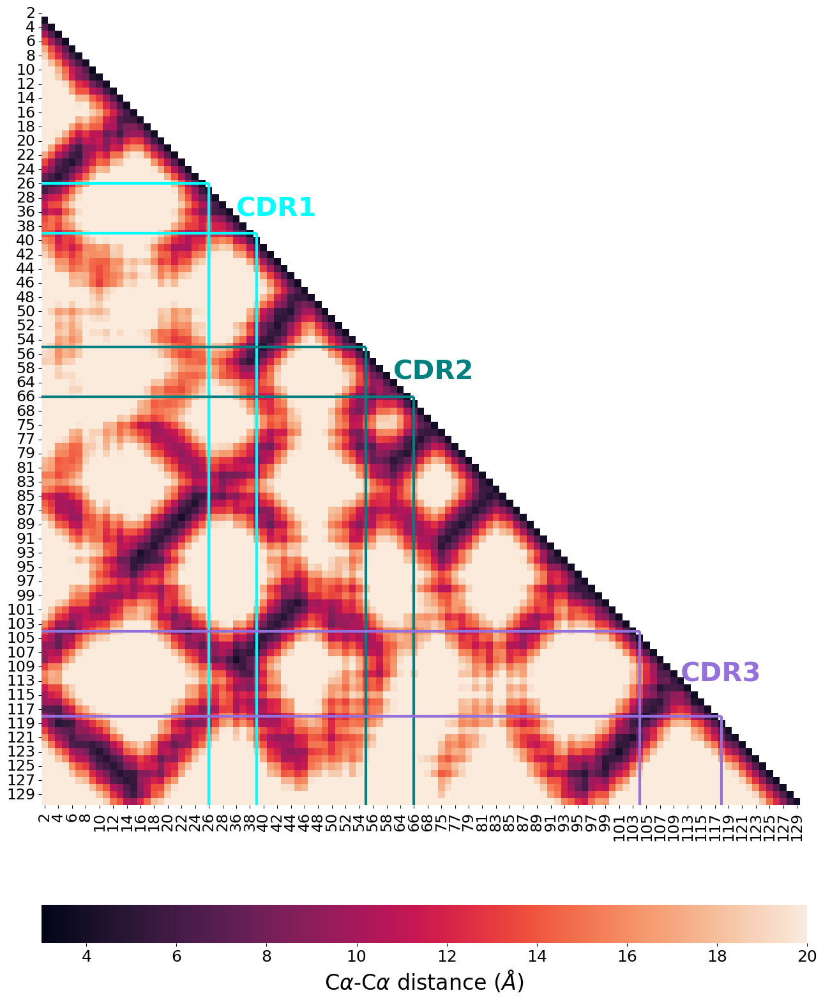

114


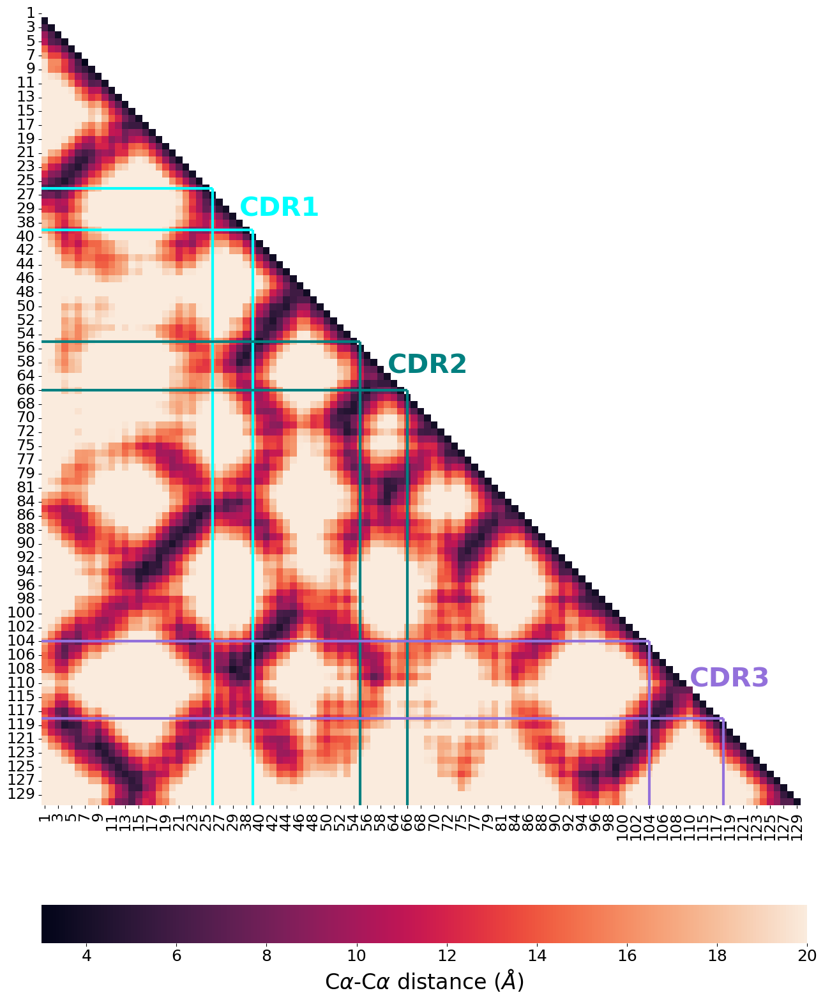

112


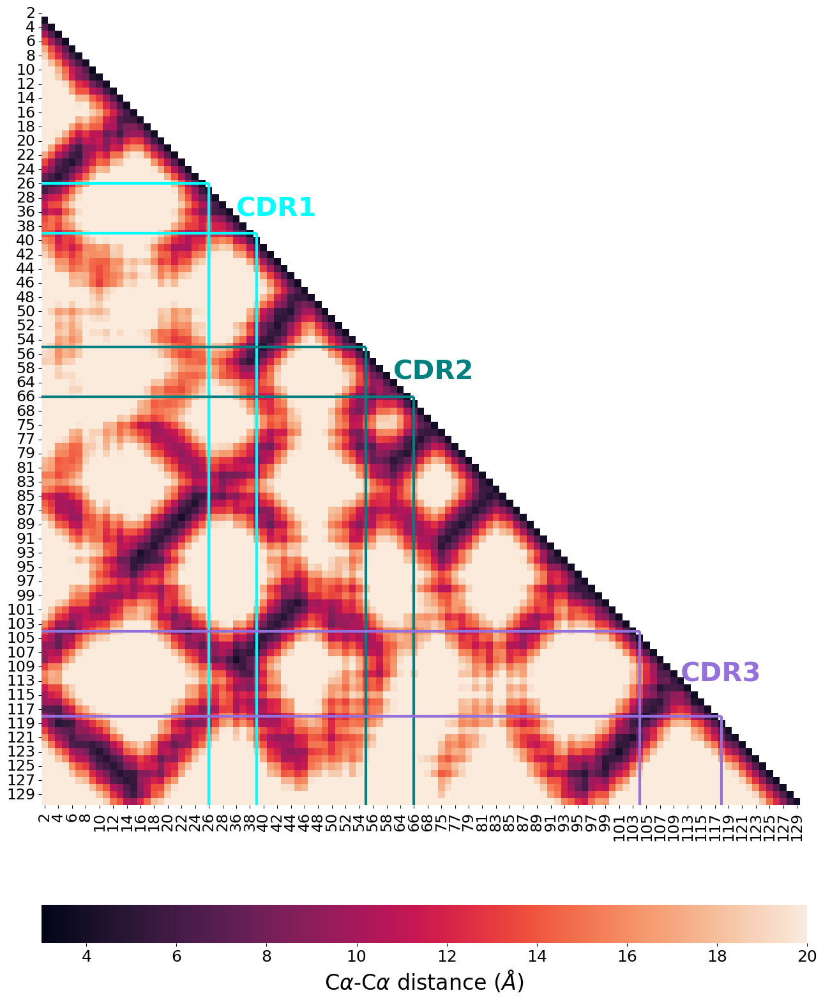

114


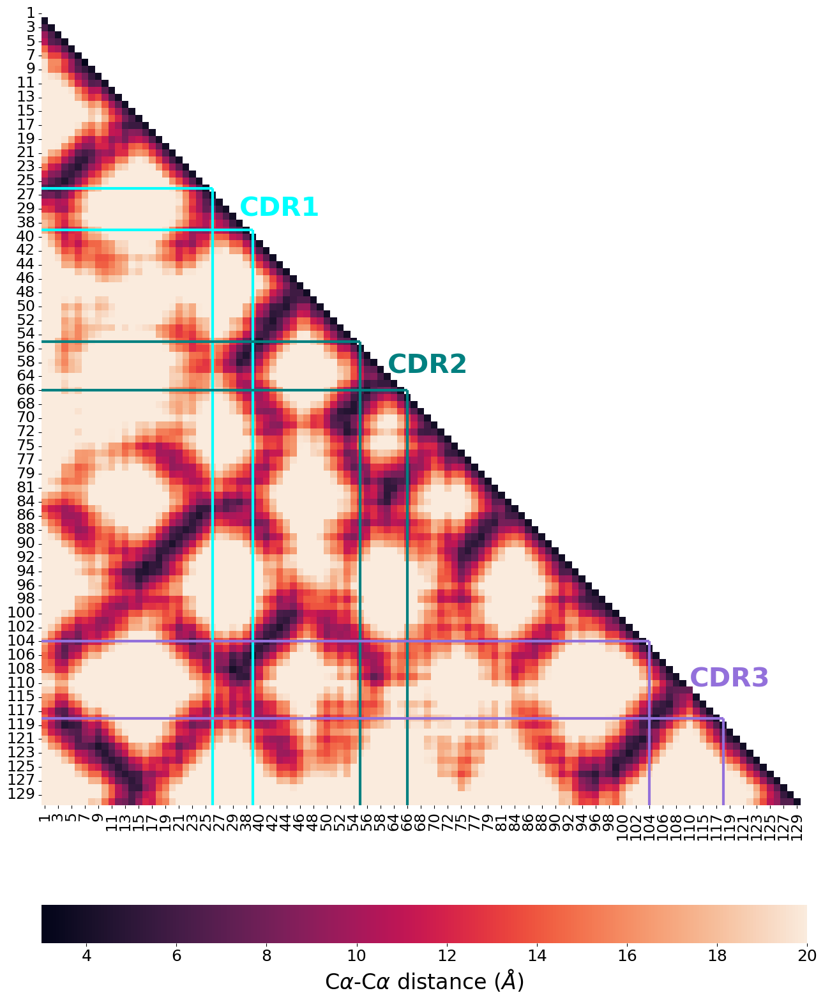

In [11]:
distance_a_df = pd.Series(distances_a['3qh3']).unstack()
distance_a_df = sort_distance_df(distance_a_df)
# print(distance_a_df)
distance_b_df = pd.Series(distances_b['3qh3']).unstack()
distance_b_df = sort_distance_df(distance_b_df)
# print(distance_b_df)
plot_heatmap(distance_a_df,
             save='yes', myoutput= f1 + '3qh3_withindist_A.png')
plot_heatmap(distance_b_df,
             save='yes', myoutput= f1 + '3qh3_withindist_B.png')

110


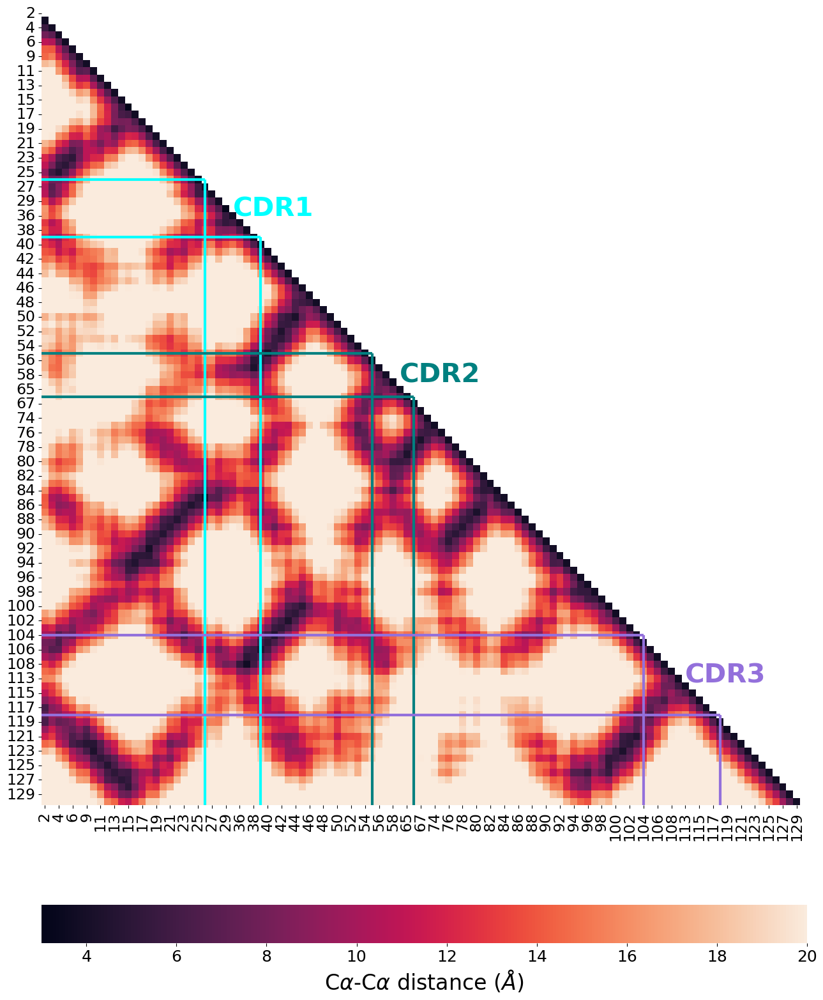

117


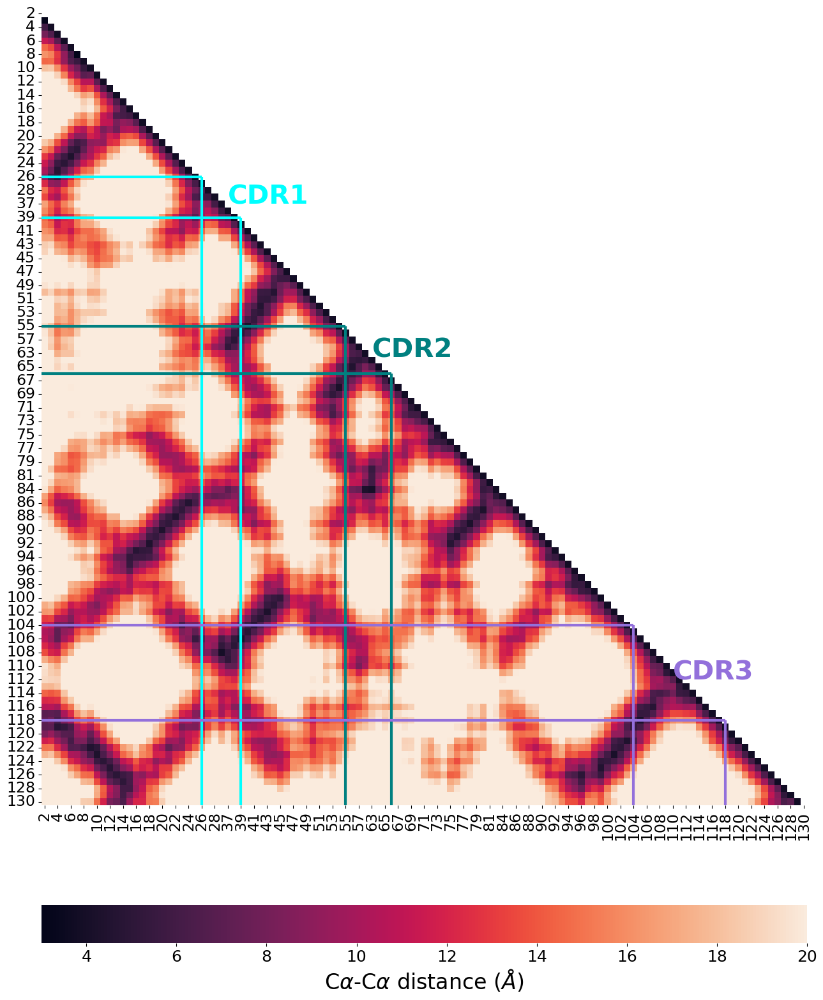

110


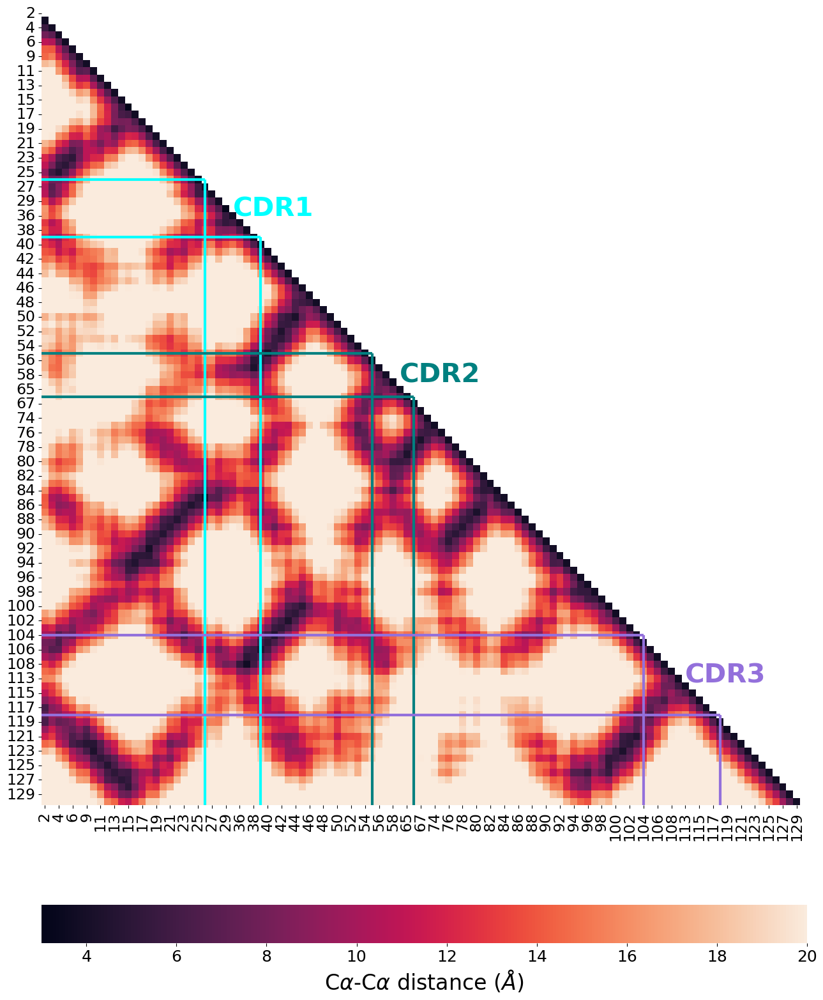

117


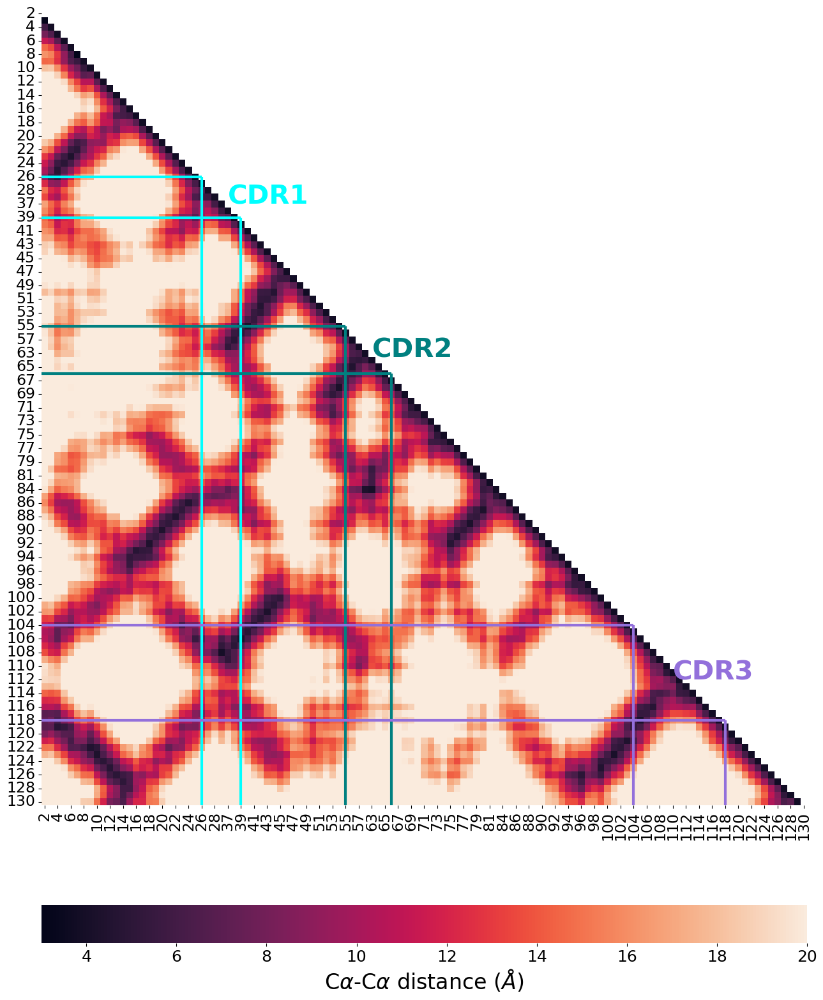

In [12]:
distance_a_df = pd.Series(distances_a['3dx9']).unstack()
distance_a_df = sort_distance_df(distance_a_df)
# print(distance_a_df)
distance_b_df = pd.Series(distances_b['3dx9']).unstack()
distance_b_df = sort_distance_df(distance_b_df)
# print(distance_b_df)
plot_heatmap(distance_a_df,
             save='yes', myoutput= f1 + '3dx9_withindist_A.png')
plot_heatmap(distance_b_df,
             save='yes', myoutput= f1 + '3dx9_withindist_B.png')

112


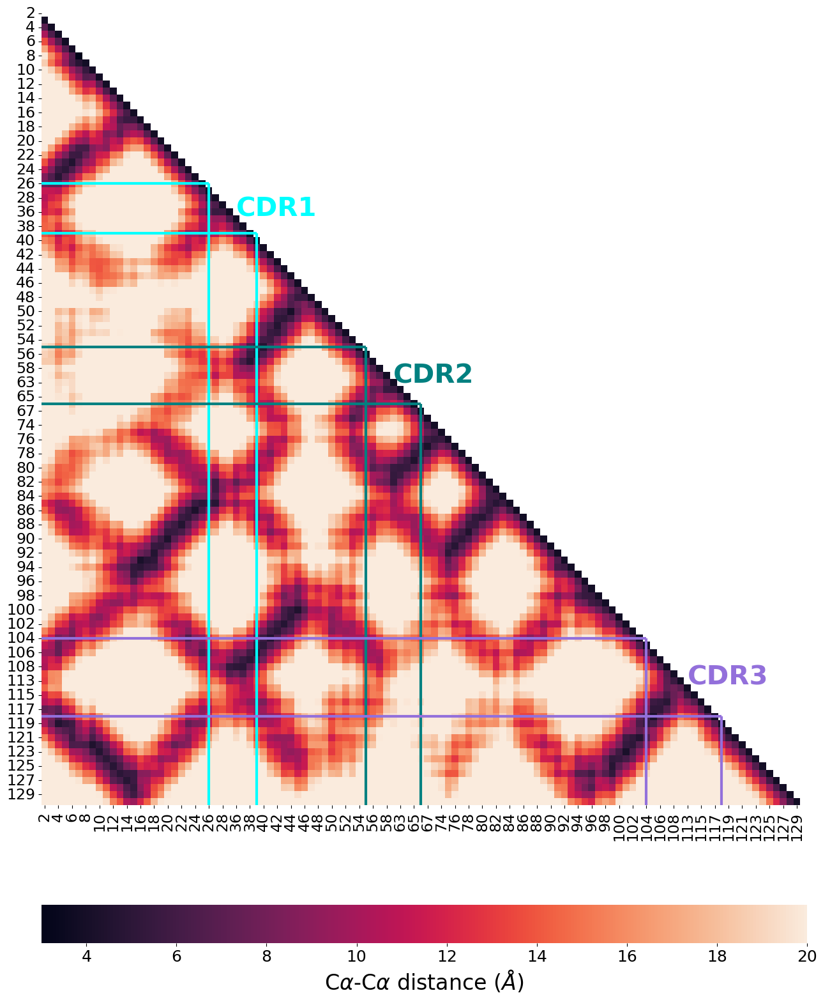

117


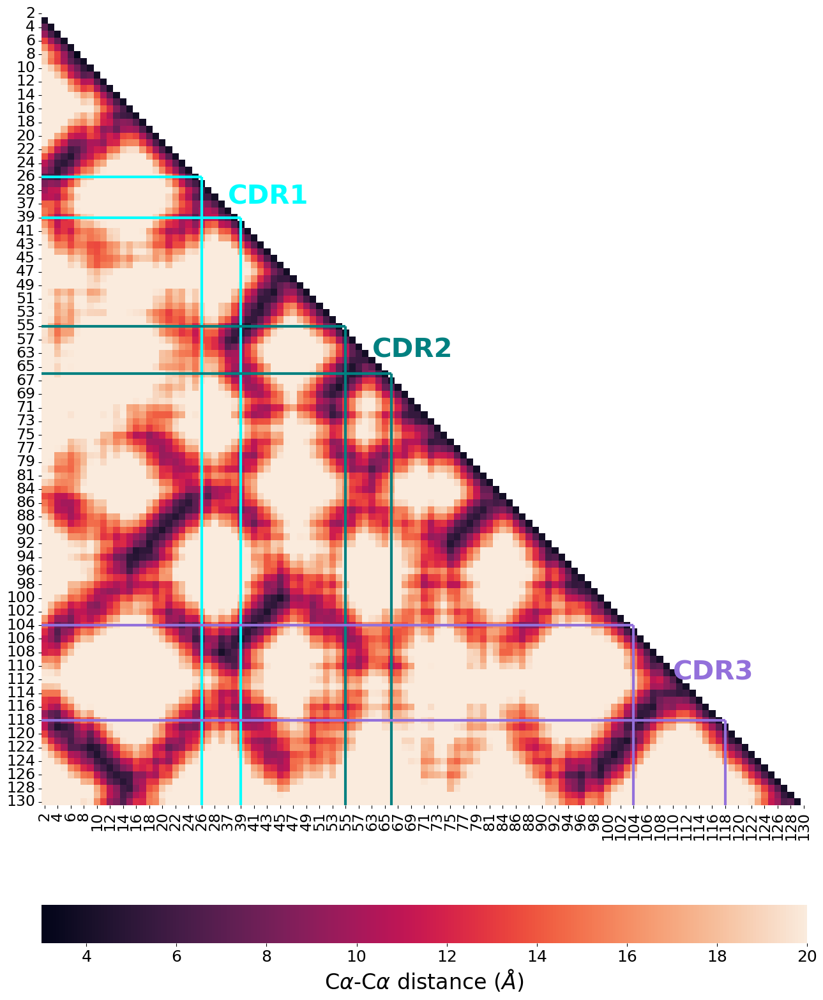

112


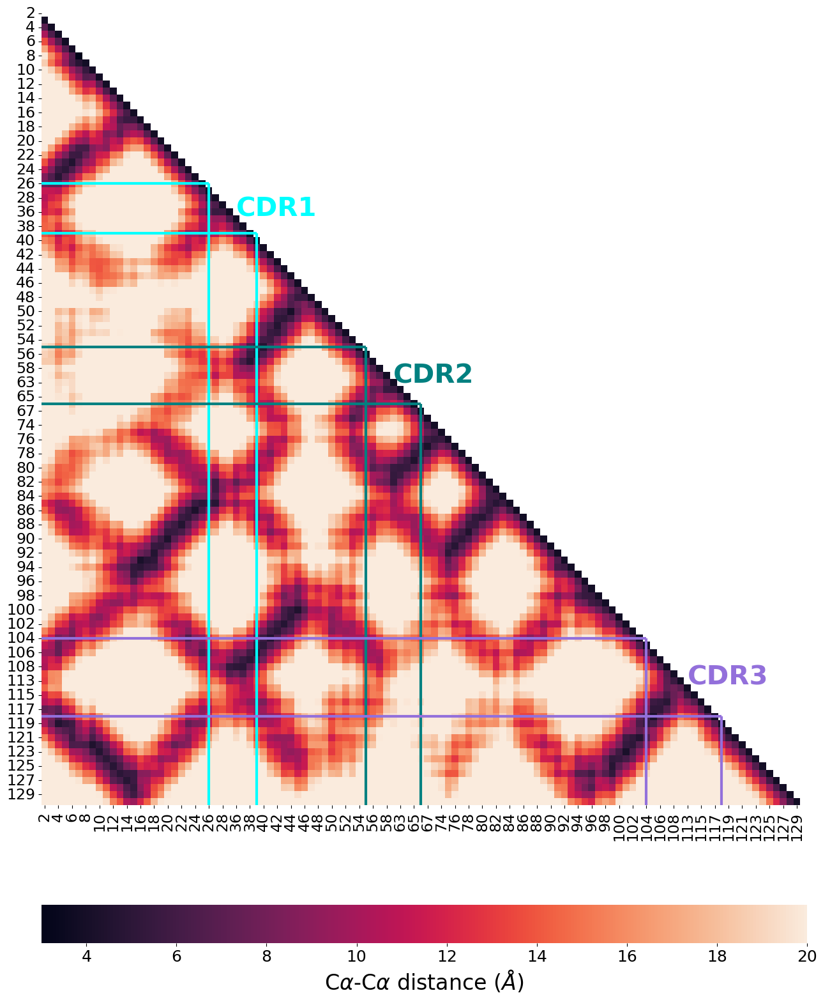

117


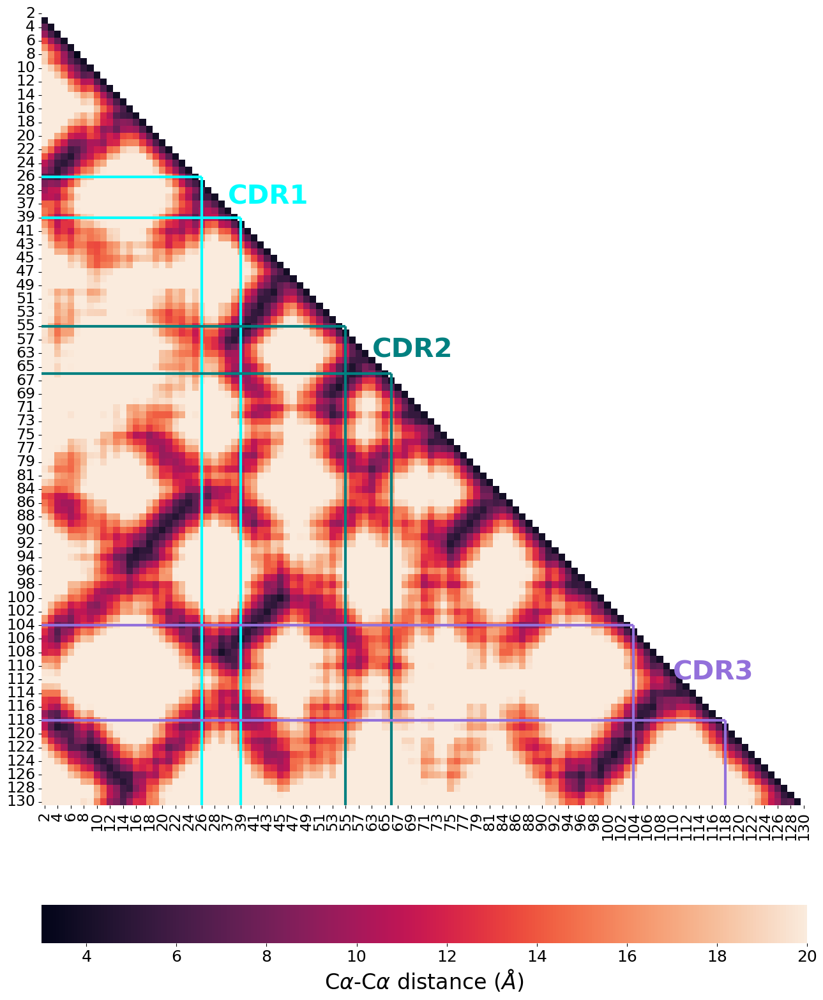

In [13]:
distance_a_df = pd.Series(distances_a['6cph']).unstack()
distance_a_df = sort_distance_df(distance_a_df)
# print(distance_a_df)
distance_b_df = pd.Series(distances_b['6cph']).unstack()
distance_b_df = sort_distance_df(distance_b_df)
# print(distance_b_df)
plot_heatmap(distance_a_df,
             save='yes', myoutput= f1 + '6cph_withindist_A.png')
plot_heatmap(distance_b_df,
             save='yes', myoutput= f1 + '6cph_withindist_B.png')

110


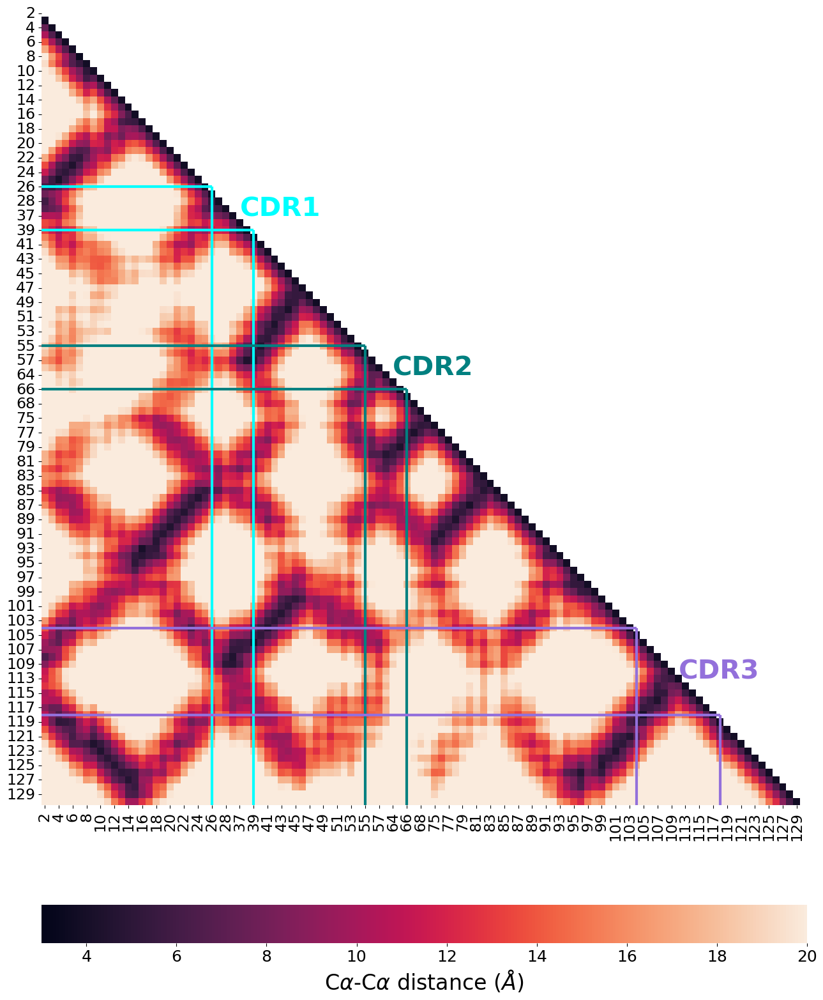

112


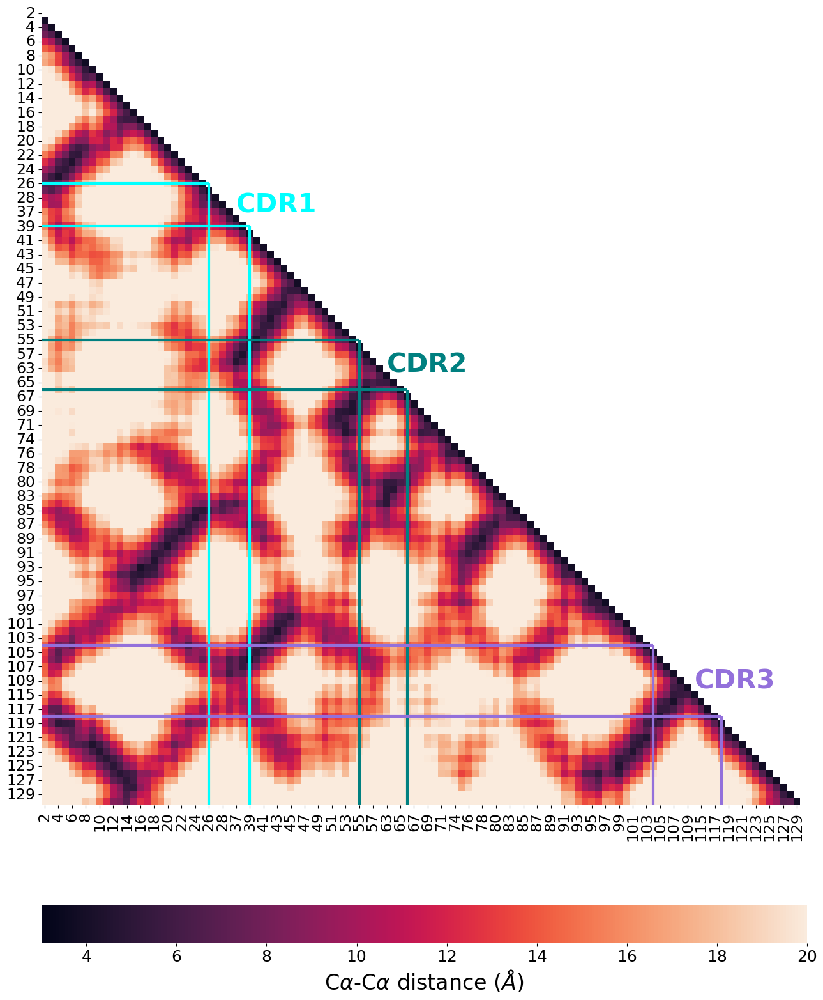

110


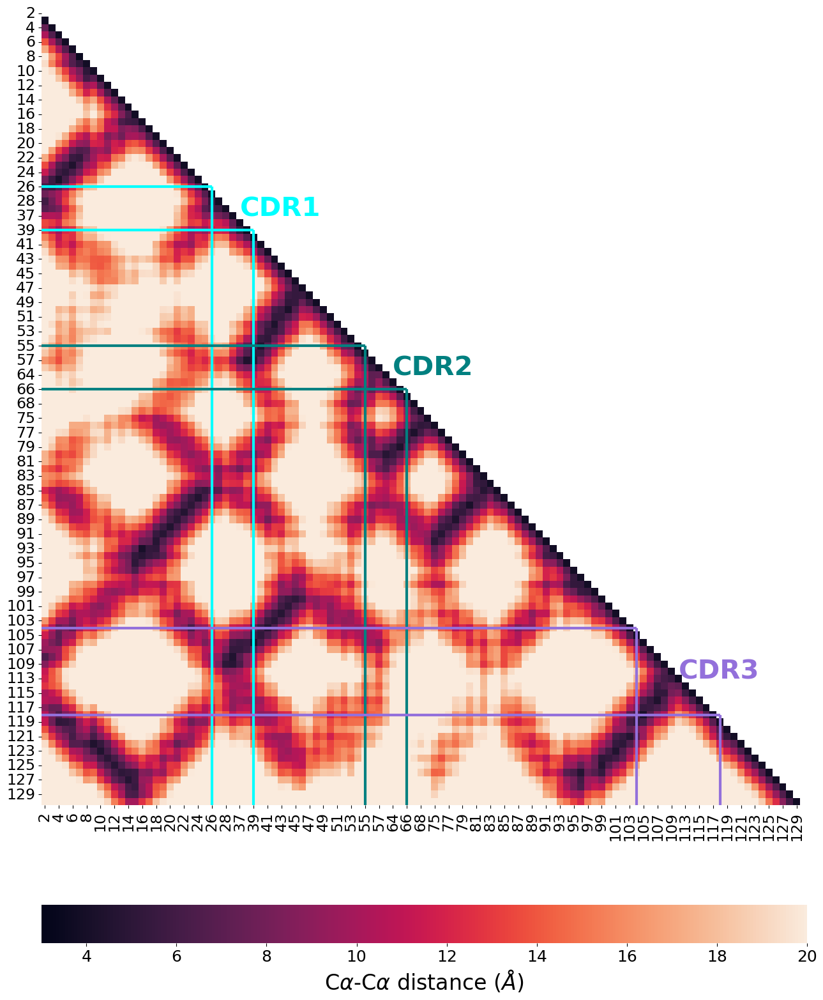

112


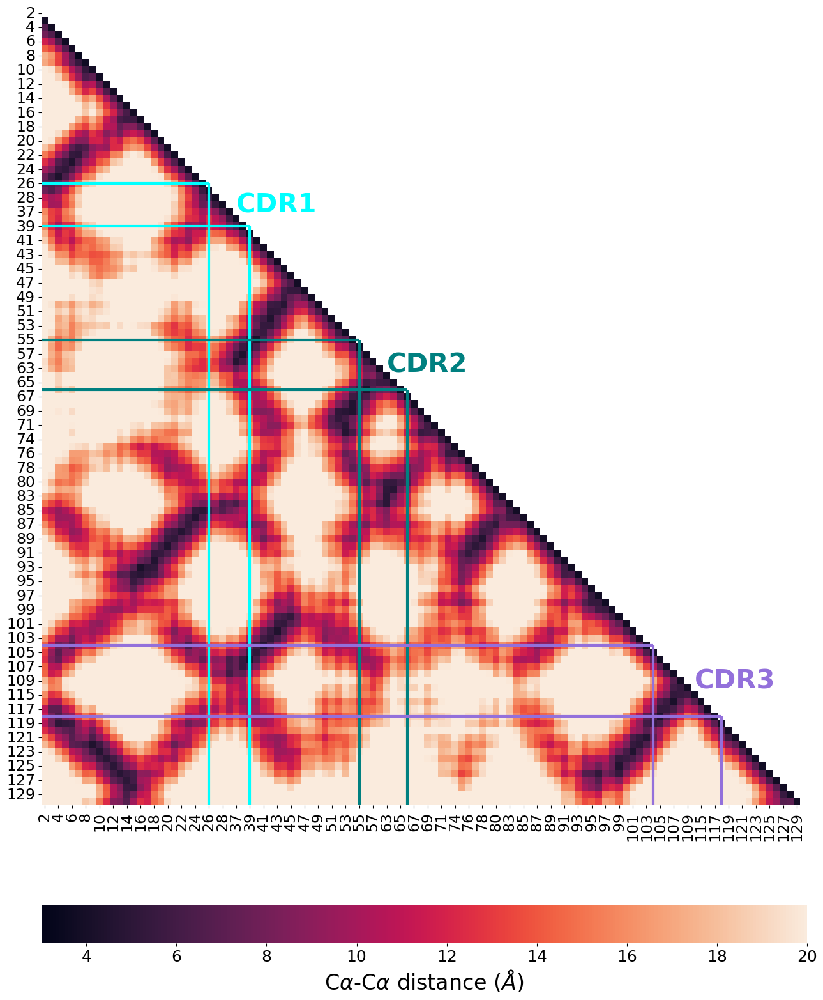

In [14]:
distance_a_df = pd.Series(distances_a['2ial']).unstack()
distance_a_df = sort_distance_df(distance_a_df)
# print(distance_a_df)
distance_b_df = pd.Series(distances_b['2ial']).unstack()
distance_b_df = sort_distance_df(distance_b_df)
# print(distance_b_df)
plot_heatmap(distance_a_df,
             save='yes', myoutput= f1 + '2ial_withindist_A.png')
plot_heatmap(distance_b_df,
             save='yes', myoutput= f1 + '2ial_withindist_B.png')

In [15]:
non_redudant_pdbs = [x[0].strip('[] \'') for x in datalist['pdb'].str.split(',')]
print(non_redudant_pdbs)
print(len(non_redudant_pdbs))

['6l9l', '7byd', '3dx9', '6zkw', '5brz', '4wnq', '7ow5', '7pb2', '7t2d', '6rpa', '6vm7', '6fra', '6eh6', '3tfk', '3vxm', '8gvb', '8gvi', '5yxu', '6vrn', '6p64', '5yxn', '5jzi', '7n5c', '5d2n', '4gg6', '4z7u', '4z7v', '7dzm', '5wjo', '6rsy', '3rgv', '1nfd', '2pxy', '2z31', '2z35', '5d7k', '4mji', '5ks9', '5ksb', '4prh', '5ksa', '2ypl', '4jry', '3utp', '3qdg', '3hg1', '4zdh', '6uz1', '3o4l', '7jwj', '4p2o', '3qib', '3qjf', '4p2q', '3qjh', '3qiu', '4qrp', '1zgl', '7nme', '6ovo', '5tez', '7z50', '6r2l', '3mbe', '6mra', '6cuh', '4dzb', '4g8e', '4g8f', '5w1v', '5e6i', '7sg1', '6vmx', '5d2l', '6cqn', '6cph', '5jhd', '2ial', '4e41', '5men', '4udt', '4mnq', '5nmd', '1ao7', '4ftv', '4l3e', '3ffc', '4g8g', '6tro', '4jfd', '2f53', '4ww1', '7r7z', '6px6', '7n2n', '5eu6', '8cx4', '3vxq', '7n2s', '7n2p', '6fr3', '6eh5', '6eh4', '2pye', '2p5e', '2f54', '2p5w', '3mv9', '3mv8', '3mv7', '2q86', '3pqy', '4ozi', '1kgc', '4ozf', '4ozg', '2esv', '4ozh', '6bj2', '7rk7', '7t2c', '6at6', '7rrg', '6avg', '6ulr',

In [16]:
reduced_dist_a = {k:distances_a[k] for k in non_redudant_pdbs}
reduced_dist_b = {k:distances_b[k] for k in non_redudant_pdbs}

In [17]:
distance_a_df = pd.DataFrame.from_dict(reduced_dist_a)
distance_a_df.T.to_csv('data/output/withinchain_Adist_uniqueTCRs.csv.gz')
print(distance_a_df)

             6l9l       7byd       3dx9       6zkw       5brz       4wnq  \
2   2    0.000000   0.000000   0.000000   0.000000   0.000000   0.000000   
    3    3.826938   3.799113   3.795089   3.879673   3.785980   3.822642   
    4    7.119657   6.145665   5.604332   6.647280   6.576518   7.029945   
    5   10.495899   9.810596   7.967438  10.124384  10.036879  10.285265   
    6   13.913894  12.877856  10.945893  13.506333  13.546537  13.707235   
...           ...        ...        ...        ...        ...        ...   
265 59        NaN        NaN        NaN        NaN        NaN        NaN   
266 59        NaN        NaN        NaN        NaN        NaN        NaN   
267 59        NaN        NaN        NaN        NaN        NaN        NaN   
268 59        NaN        NaN        NaN        NaN        NaN        NaN   
269 59        NaN        NaN        NaN        NaN        NaN        NaN   

             7ow5       7pb2       7t2d       6rpa  ...  7pbe      3sjv  7rm4  \
2   2 

In [18]:
# remove rows for which I have less than 75% of values
min_count_a = distance_a_df.shape[1]*0.75
d0_a = distance_a_df.dropna(axis = 0, thresh = min_count_a)

In [19]:
d0_a

6l9l       7byd       3dx9       6zkw       5brz       4wnq  \
3   3    0.000000   0.000000   0.000000   0.000000   0.000000   0.000000   
    4    3.807300   3.777689   3.847705   3.884156   3.775355   3.822804   
    5    6.917591   6.738339   7.036433   6.687815   6.666255   6.569466   
    6   10.353395  10.238897  10.492473  10.340108  10.393295  10.124402   
    8   13.780804  13.699292  14.083013  15.638173  15.749226  15.505742   
...           ...        ...        ...        ...        ...        ...   
126 63        NaN        NaN        NaN  29.335407  28.994621  30.067741   
127 7         NaN        NaN        NaN  19.356386  20.096127  21.395805   
    63        NaN        NaN        NaN  33.131016  32.463757  33.439949   
128 7         NaN        NaN        NaN  22.881578  23.643723  25.073544   
129 7         NaN        NaN        NaN  24.899616  25.813429  26.387859   

             7ow5       7pb2       7t2d       6rpa  ...       7pbe       3sjv  \
3   3    0.000000   0.000000   0.000000   0.000000  ...   0.000000   0.000000   
    4    3.825321   3.888678   3.807367   3.802772  ...   3.788622   3.801118   
    5    6.448707   6.850571   6.561038   6.847430  ...   5.925237   6.341195   
    6   10.084083  10.411460  10.126251  10.118096  ...   9.642103   9.699082   
    8   15.204975  15.742290  15.494316  15.651624  ...  13.102653  15.182155   
...           ...        ...        ...        ...  ...        ...        ...   
126 63  29.440567  29.624218  30.185387  26.626194  ...        NaN        NaN   
127 7   21.576262  21.094870  21.458019  21.022957  ...  19.192781  18.551775   
    63  33.126160  33.215160  33.767838  30.113718  ...        NaN        NaN   
128 7   25.201645  24.513588  25.021774  24.596310  ...  22.718666  22.156952   
129 7   27.114618  25.942518  27.033455  26.971432  ...  24.761469  24.700560   

             7rm4       6ovn       7phr       7t2b  1ymm       3e3q  \
3   3    0.000000        NaN        NaN        NaN   NaN   0.000000   
    4    3.819884        NaN        NaN        NaN   NaN   3.835668   
    5    7.237598        NaN        NaN        NaN   NaN   6.769577   
    6   10.015491        NaN        NaN        NaN   NaN  10.298224   
    8   16.736530        NaN        NaN        NaN   NaN  15.618945   
...           ...        ...        ...        ...   ...        ...   
126 63  29.041800  29.469254  28.855909  29.150928   NaN  27.531288   
127 7   20.819368        NaN        NaN        NaN   NaN  21.762173   
    63  32.591583  33.121361  32.260994  32.603329   NaN  30.856859   
128 7   24.107584        NaN        NaN        NaN   NaN        NaN   
129 7   26.632715        NaN        NaN        NaN   NaN        NaN   

             3e2h       5euo  
3   3    0.000000   0.000000  
    4    3.829685   3.774286  
    5    6.555334   6.554376  
    6   10.189192  10.215322  
    8   15.585049  15.858464  
...           ...        ...  
126 63  27.675007  28.419933  
127 7   21.984800  19.373428  
    63  31.061106  31.914549  
128 7         NaN  22.570181  
129 7         NaN  25.148222  

[34541 rows x 214 columns]

In [20]:
# take the avg of each value
avg_a = d0_a.mean(axis = 1)
# now make the average a matrix itself
d1_a = avg_a.unstack()

# also calculate number of structures that make contact
count_a = d0_a[d0_a <= 10].T.count().unstack()

110


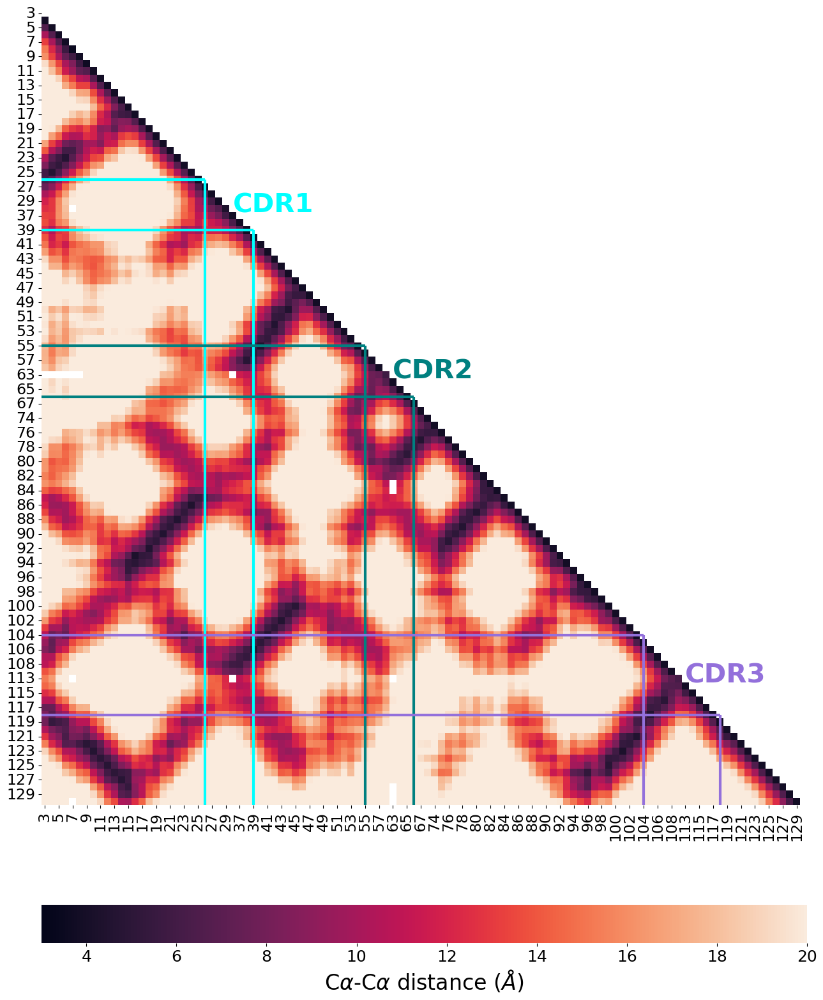

110


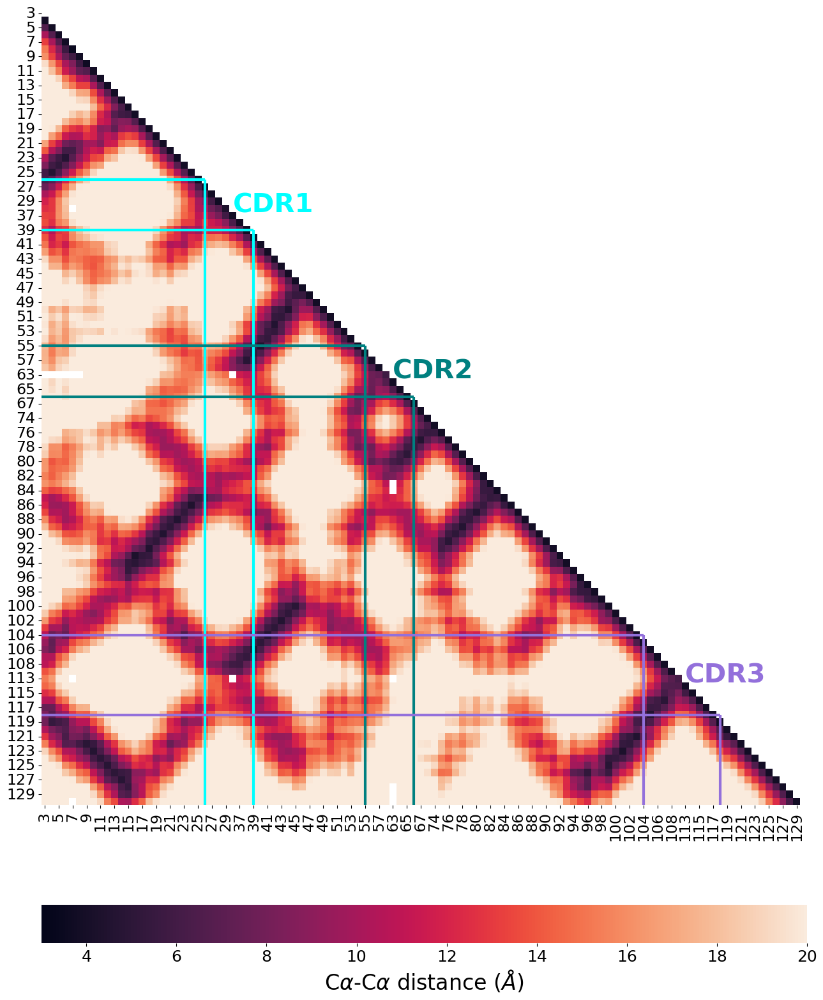

In [21]:
plot_heatmap(sort_distance_df(d1_a),
             save='yes', myoutput= f1 + 'avgA_withinchain.png')

110


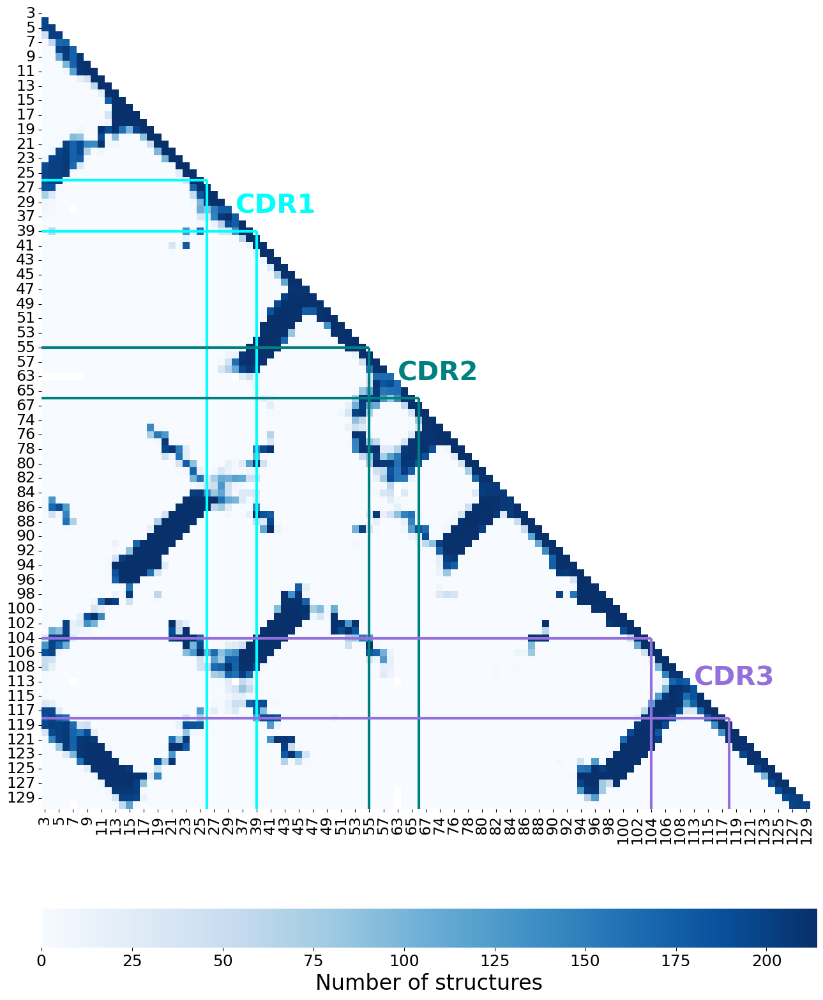

110


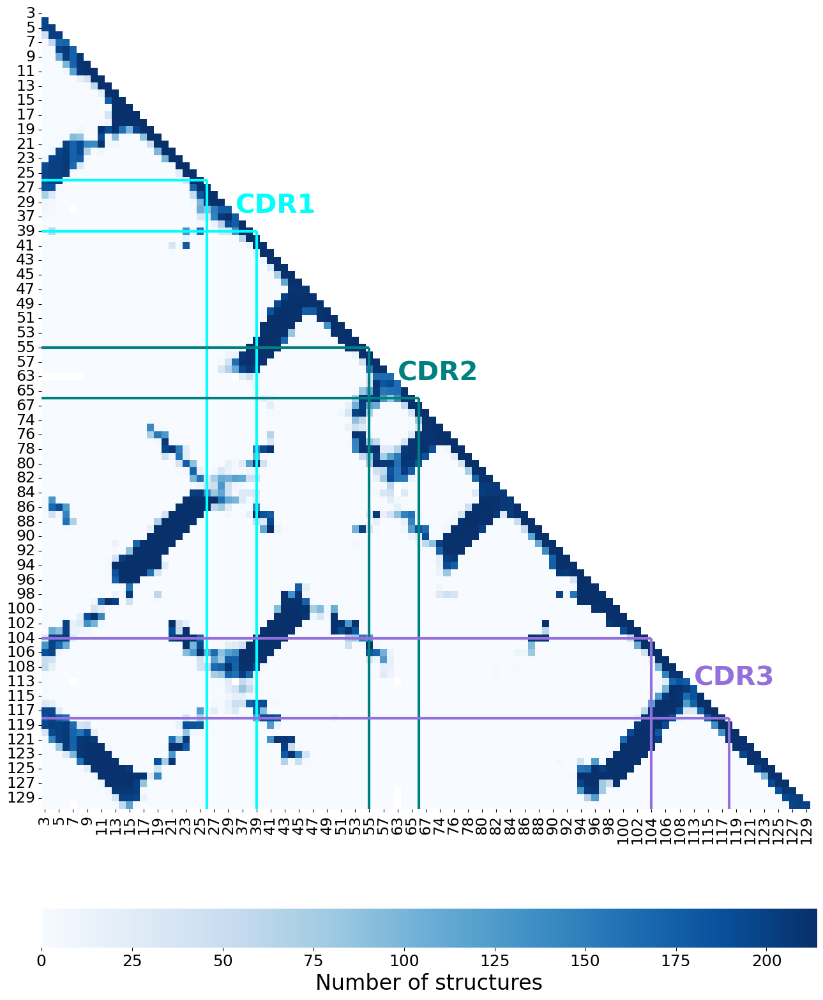

In [22]:
plot_heatmap(sort_distance_df(count_a), cmap = 'Blues', vmin=0, vmax=len(non_redudant_pdbs),
             clabel = 'Number of structures',
             save='yes', myoutput= f1 + 'countA_withinchain.png')

In [23]:
distance_b_df = pd.DataFrame.from_dict(reduced_dist_b)
distance_b_df.T.to_csv('data/output/withinchain_Bdist_uniqueTCRs.csv.gz')

In [24]:
# remove rows for which I have less than 75% of values
min_count_b = distance_b_df.shape[1]*0.75
d0_b = distance_b_df.dropna(axis = 0, thresh = min_count_b)

In [25]:
# take the avg of each value
avg_b = d0_b.mean(axis = 1)
# now make the average a matrix itself
d1_b = avg_b.unstack()

# also calculate number of structures that make contact
count_b = d0_b[d0_b <= 10].T.count().unstack()

113


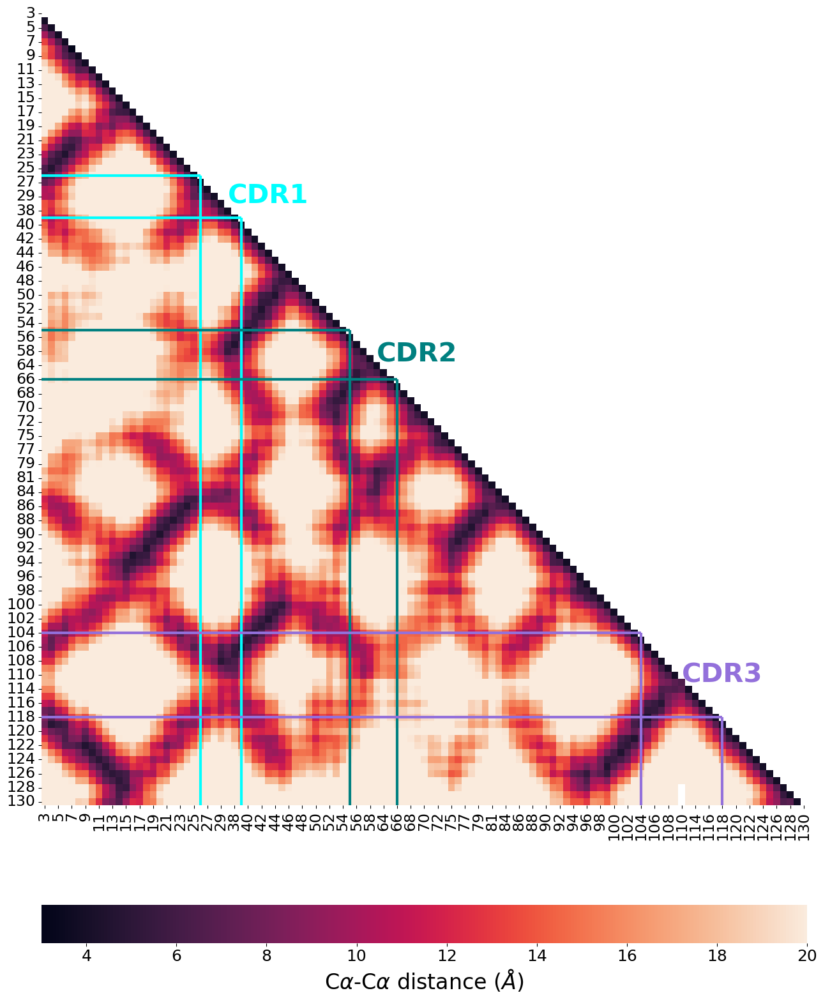

113


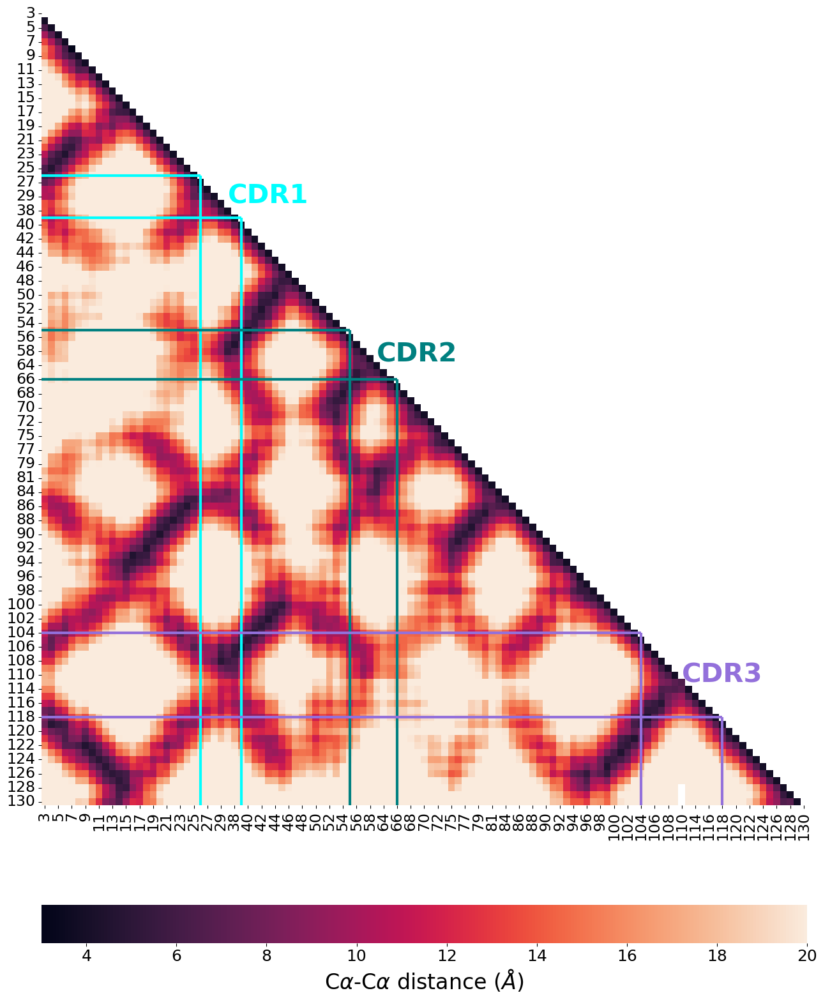

In [26]:
plot_heatmap(sort_distance_df(d1_b),
             save='yes', myoutput= f1 + 'avgB_withinchain.png')

113


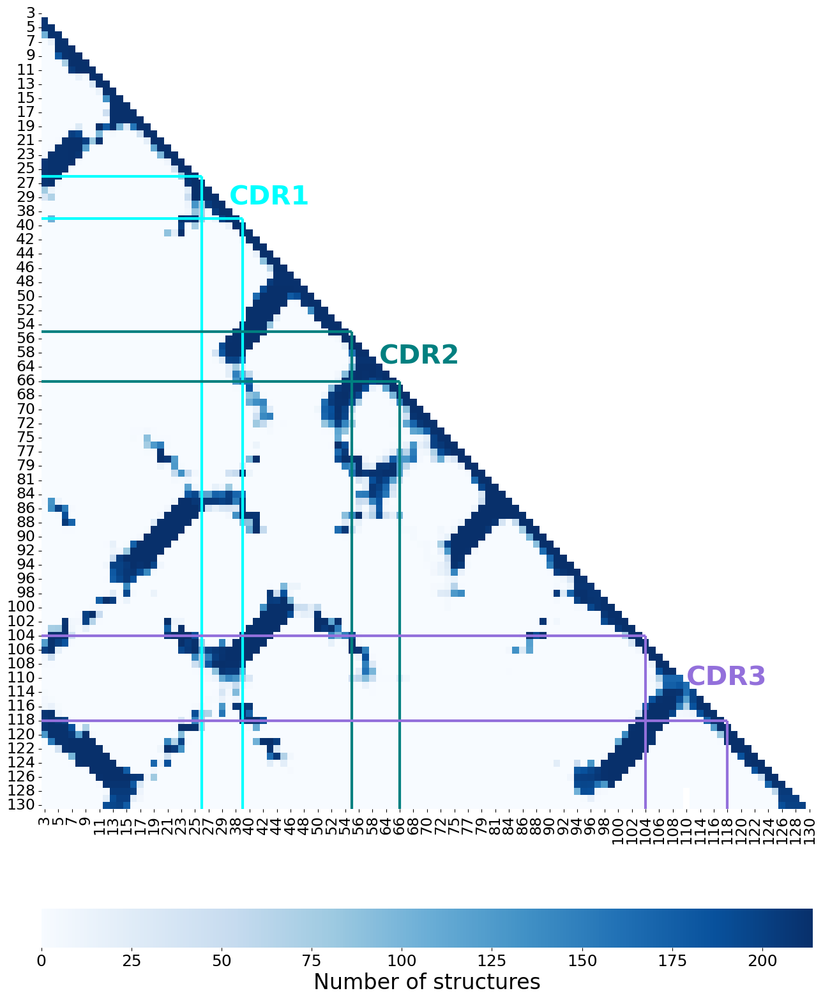

113


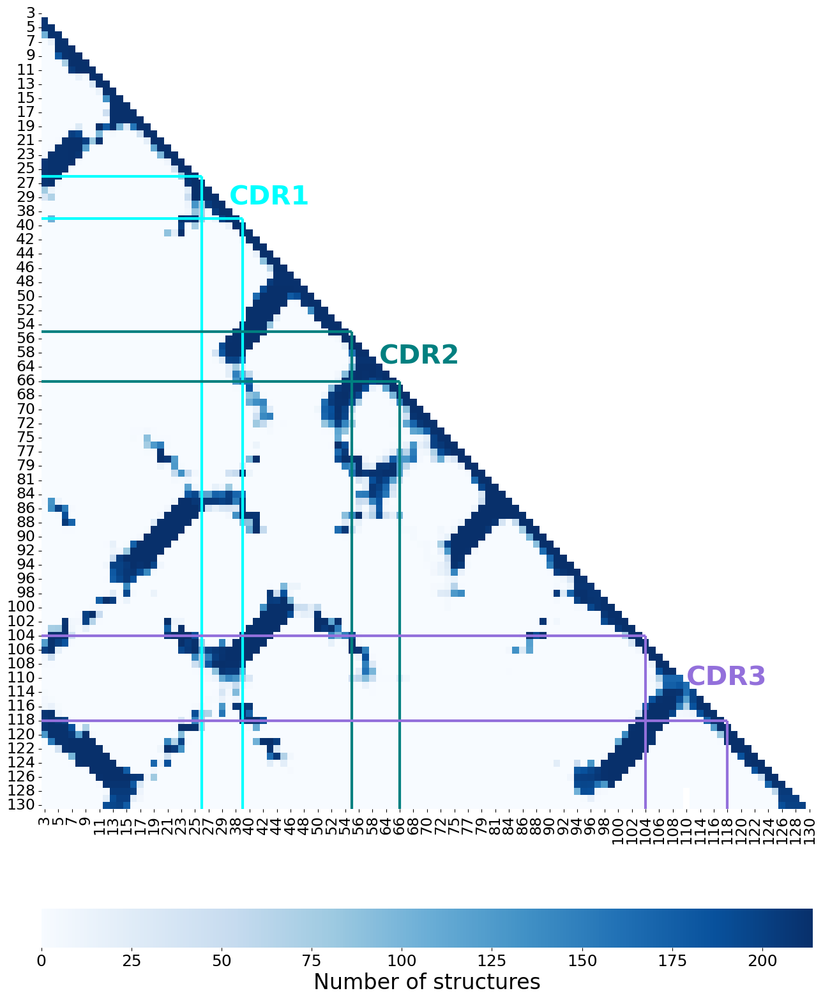

In [27]:
plot_heatmap(sort_distance_df(count_b), cmap = 'Blues', vmin=0, vmax=len(non_redudant_pdbs), 
             clabel = 'Number of structures',
             save='yes', myoutput= f1 + 'countB_withinchain.png')

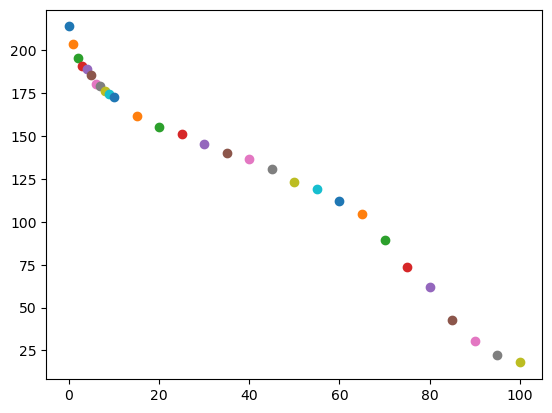

(187, 187)
(187, 188)
3      179.333333
4      184.333333
5      184.333333
6      187.333333
8      190.333333
          ...    
205    160.833333
206    155.833333
207    148.333333
7      155.333333
63     148.333333
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


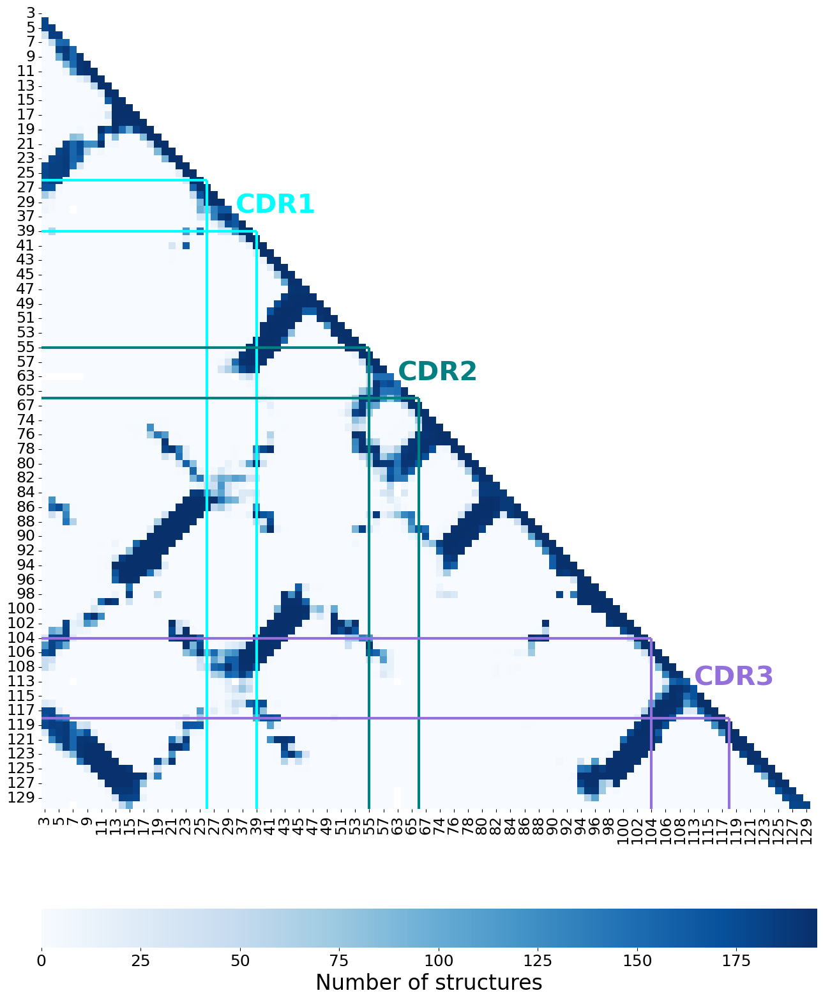

110


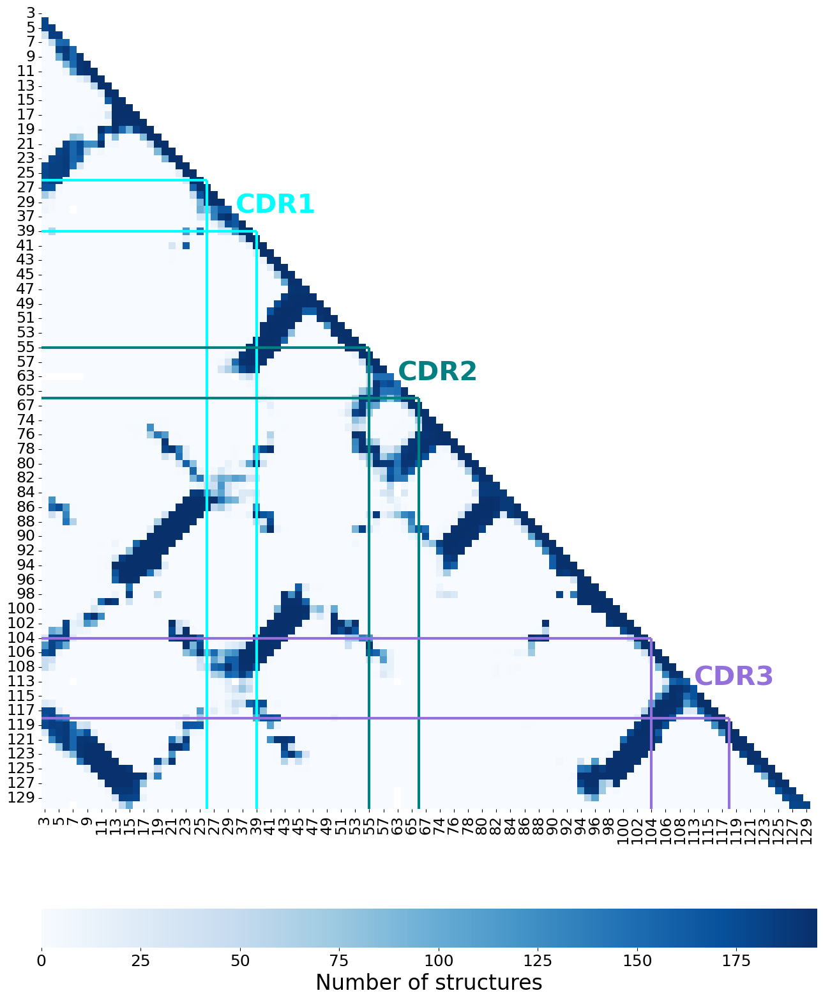

(187, 187)
(187, 188)
3      157.083333
4      162.083333
5      162.083333
6      165.083333
8      168.083333
          ...    
205    145.666667
206    140.666667
207    135.333333
7      135.083333
63     129.750000
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


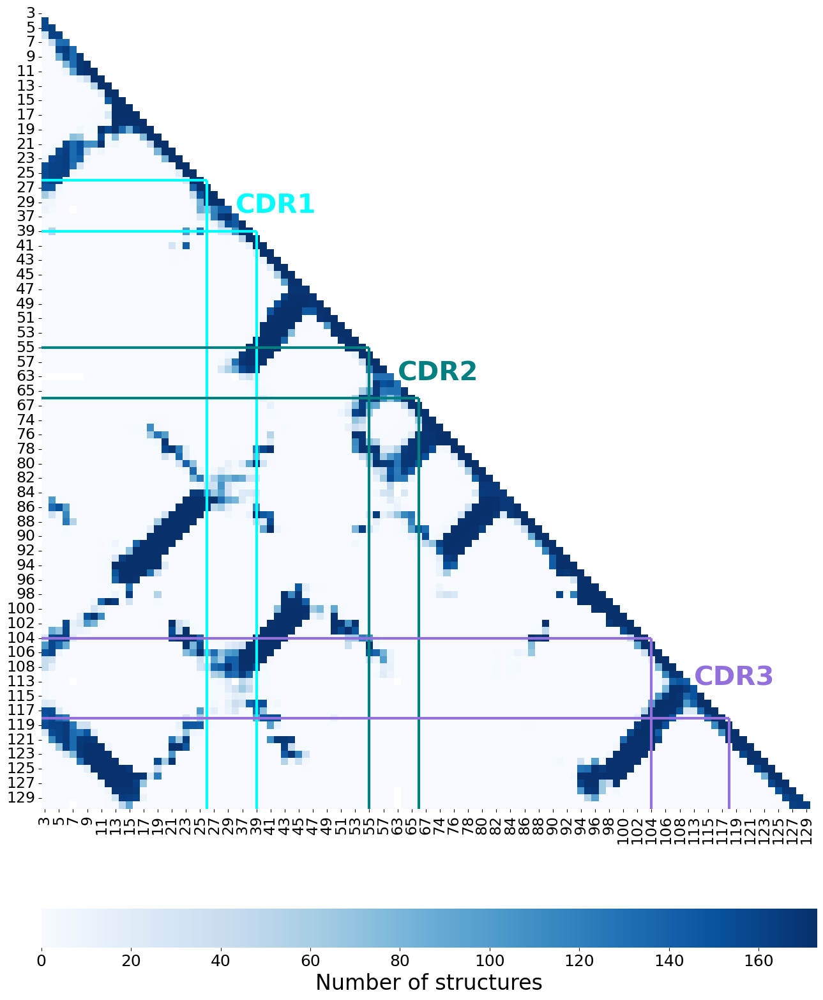

110


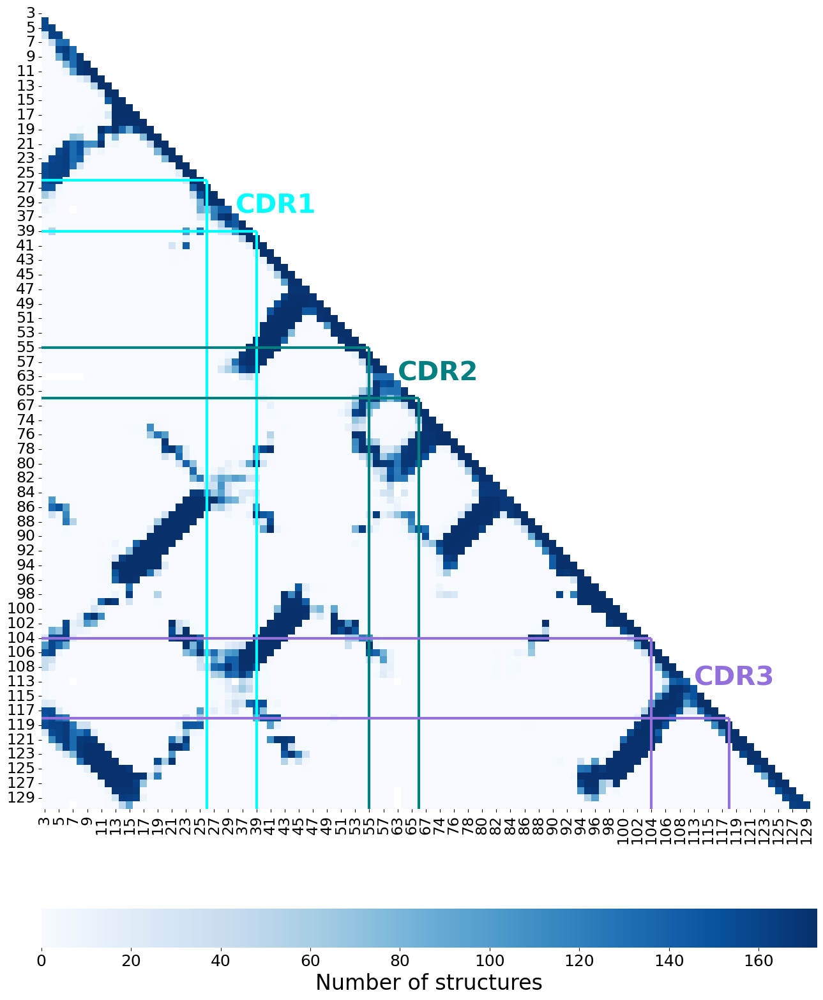

(187, 187)
(187, 188)
3      145.566667
4      150.566667
5      150.566667
6      153.566667
8      156.566667
          ...    
205    137.566667
206    132.566667
207    127.650000
7      125.233333
63     120.233333
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


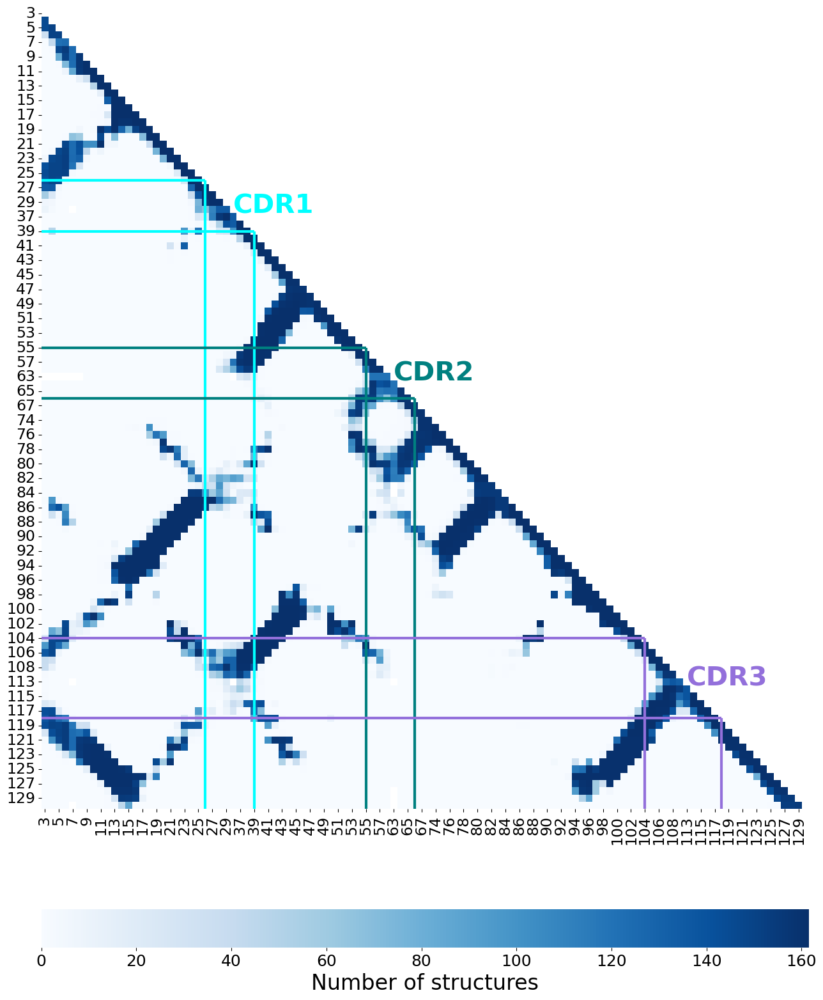

110


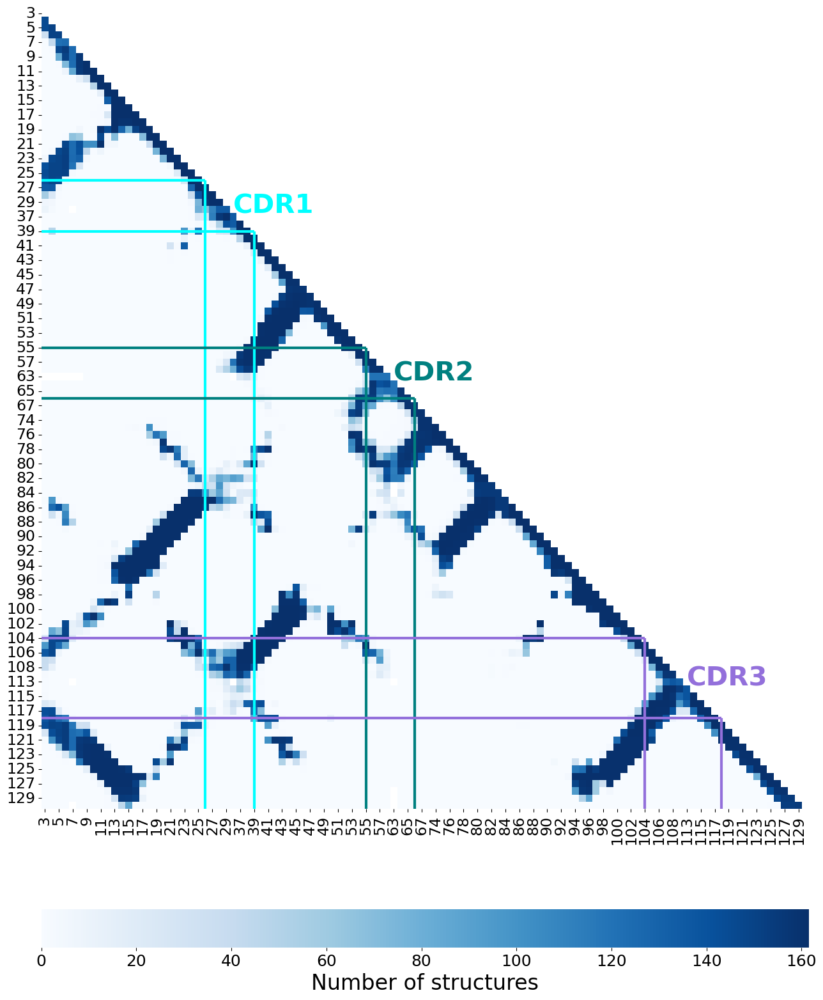

(187, 187)
(187, 188)
3      109.483333
4      112.433333
5      112.433333
6      115.433333
8      118.433333
          ...    
205    104.596429
206    100.929762
207     96.679762
7       94.100000
63      92.600000
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


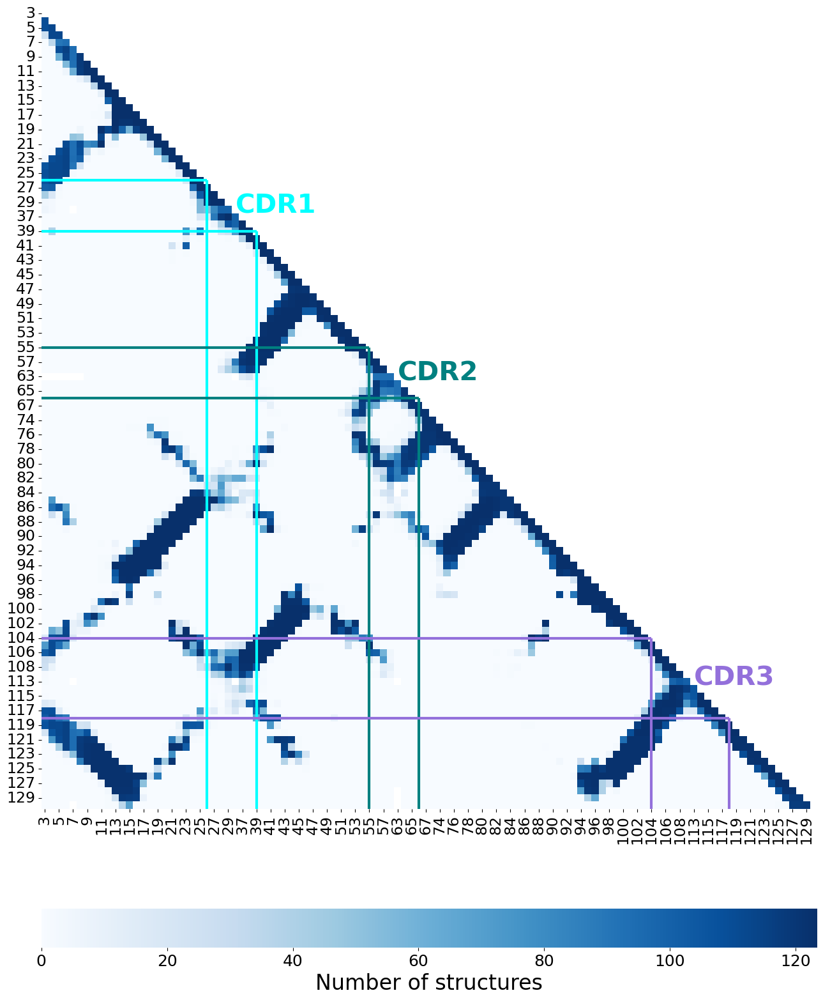

110


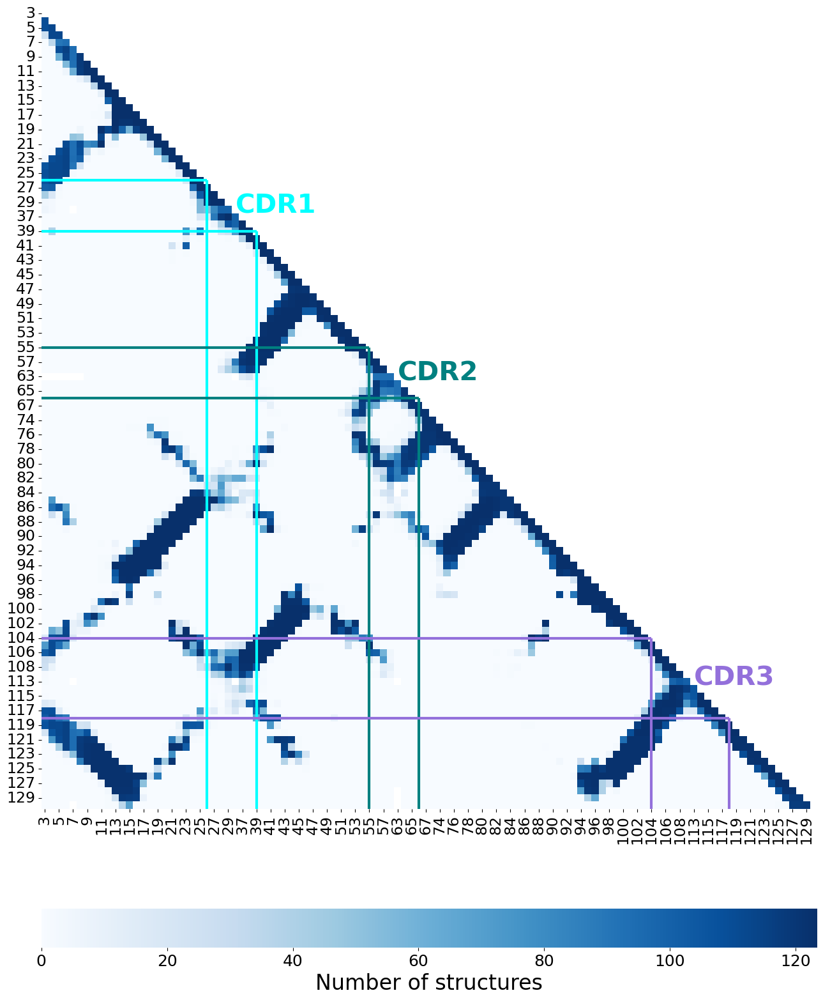

(187, 187)
(187, 188)
3      64.253163
4      66.053759
5      66.053759
6      68.387092
8      69.587092
         ...    
205    59.000707
206    56.967374
207    54.864596
7      56.974790
63     57.092972
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


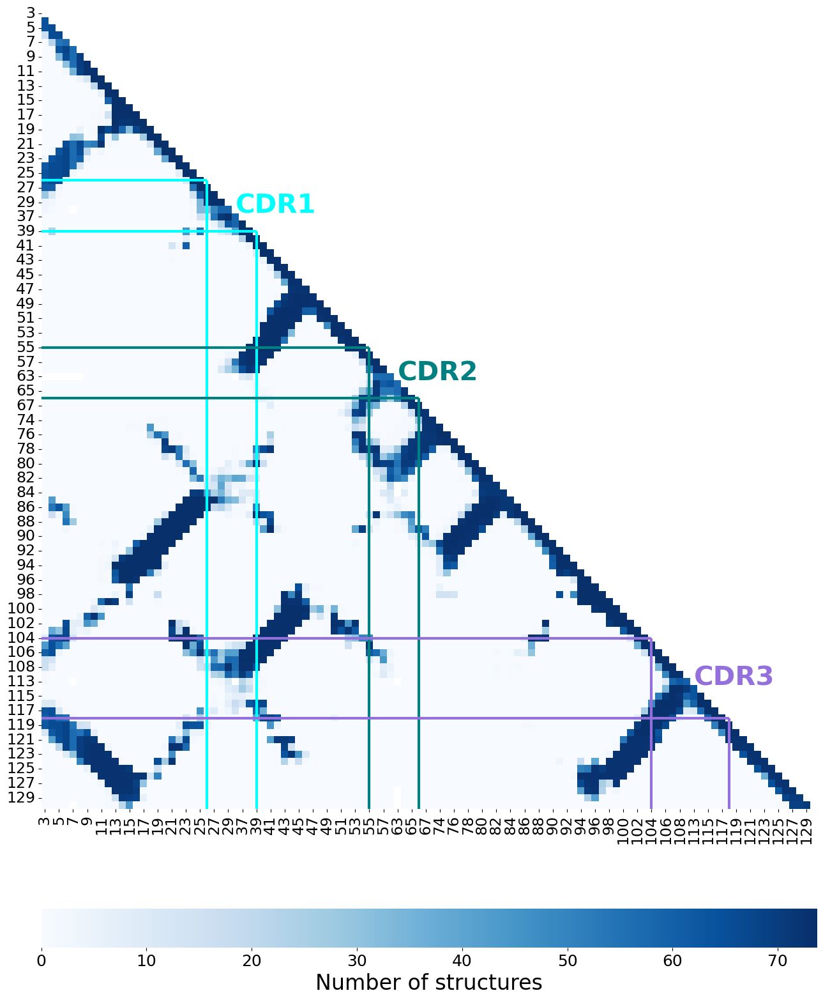

110


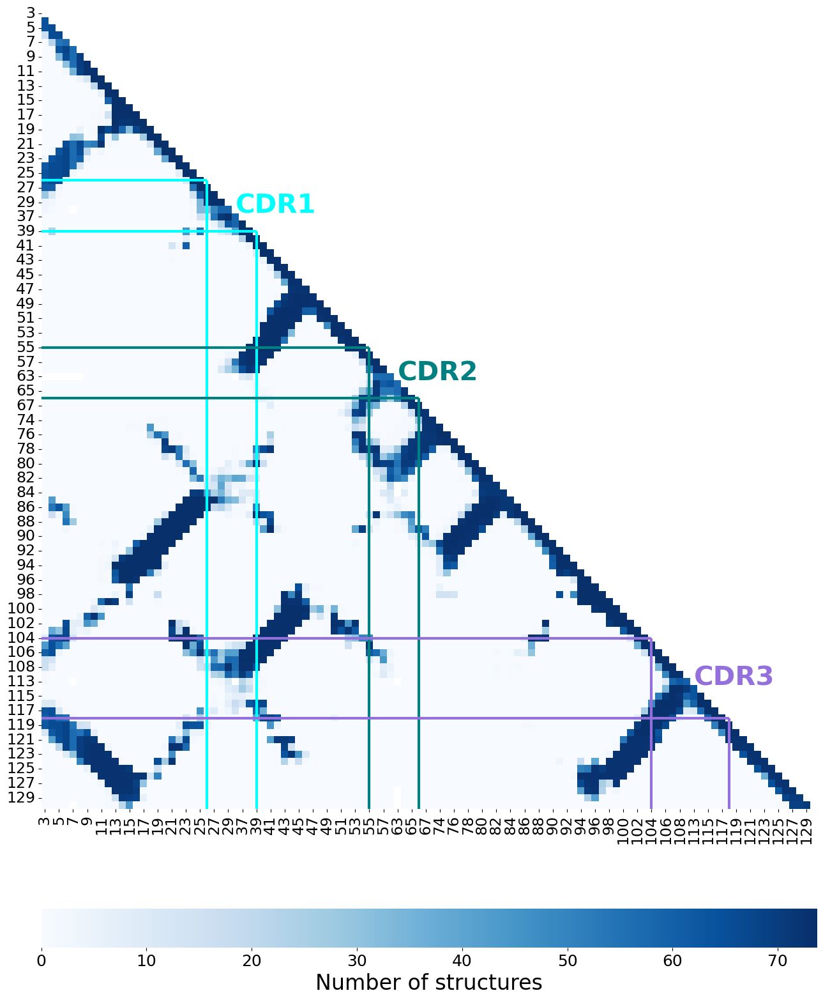

(187, 187)
(187, 188)
3      16.822890
4      17.061903
5      17.061903
6      17.389554
8      17.490516
         ...    
205    14.854476
206    14.133052
207    13.560114
7      13.221784
63     13.514241
Length: 187, dtype: float64
3      197.0
4      202.0
5      202.0
6      206.0
8      209.0
       ...  
206    174.0
207    166.0
7      173.0
63     164.0
C      219.0
Length: 188, dtype: float64
110


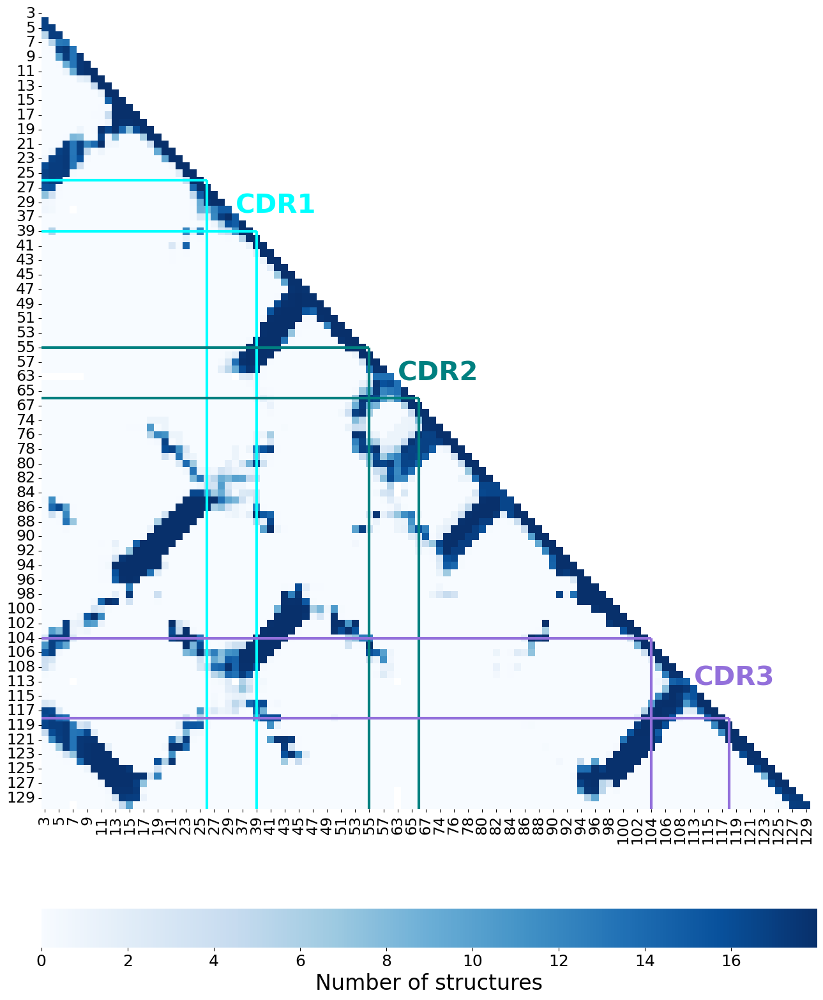

110


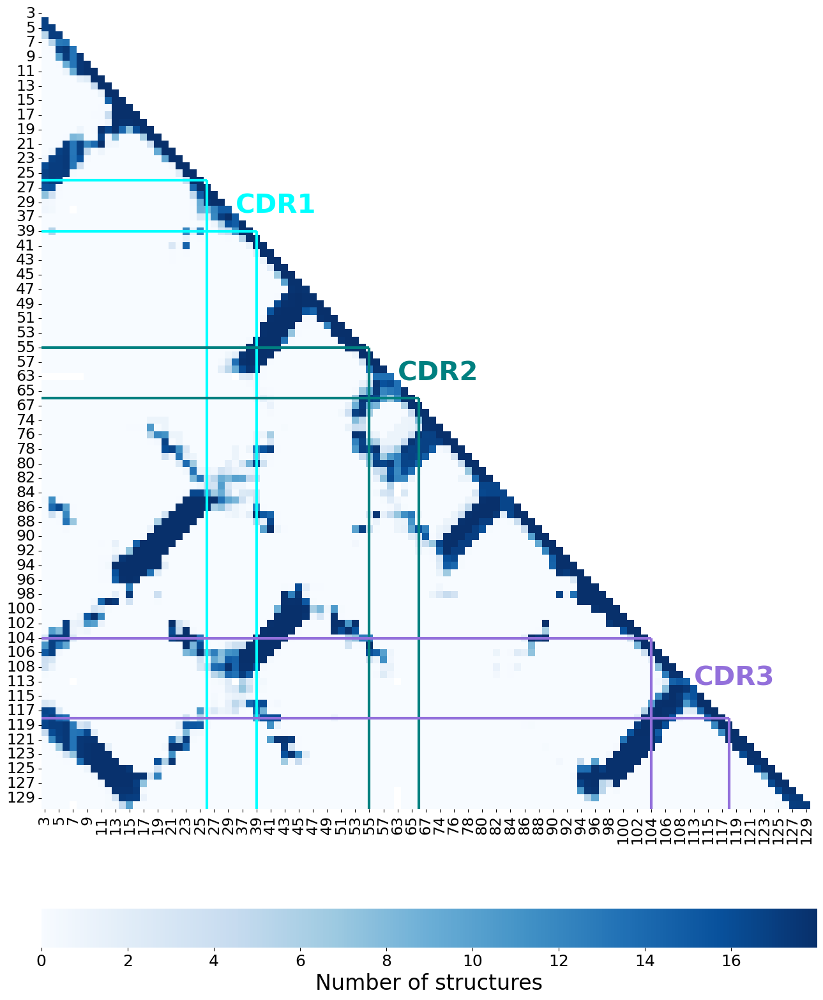

In [28]:
#Now add a heatmap where I look using the structure weights

ax = plt.subplot()
for d in [0,1,2,3,4,5,6,7,8,9,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100]:
    weigth_vector = [1/np.sum(ab_dists[i] <= d) for i in range(ab_dists.shape[0])]
    ax.scatter(d, sum(weigth_vector))
plt.show()

x = count_a

for d in [2,10,15,50,75,100]:
    contacts = (d0_a <= 10).astype(int).T
    weigth_vector = [1/np.sum(ab_dists[i] <= d) for i in range(ab_dists.shape[0])]
    contacts_weighted = contacts.mul(weigth_vector, axis=0).sum().unstack()
    print(contacts_weighted.shape)
    print(count_a.shape)
    if d == 100:
        y = contacts_weighted
    print(contacts_weighted.max())
    print(count_a.max())

    plot_heatmap(sort_distance_df(contacts_weighted), vmin=0, vmax=sum(weigth_vector),cmap='Blues',
                clabel = 'Number of structures',
                save='yes', myoutput= f1 + 'effective_countA_withinchain_'+str(d)+'.png')

In [29]:
print(x)
print(y)

         3      4      5      6      8      9     10     11    12   13  ...  \
3    197.0  197.0  197.0   44.0    0.0    0.0    0.0    0.0   0.0  0.0  ...   
4    197.0  202.0  202.0  202.0    1.0    0.0    0.0    0.0   0.0  0.0  ...   
5    197.0  202.0  202.0  202.0  198.0  112.0    1.0    0.0   0.0  0.0  ...   
6     44.0  202.0  202.0  206.0  206.0  203.0   99.0    9.0   0.0  0.0  ...   
8      0.0    1.0  198.0  206.0  209.0  209.0  209.0  208.0  16.0  0.0  ...   
..     ...    ...    ...    ...    ...    ...    ...    ...   ...  ...  ...   
205    0.0    0.0    0.0    0.0    0.0    0.0    0.0    0.0   0.0  0.0  ...   
206    NaN    0.0    0.0    0.0    0.0    0.0    0.0    0.0   0.0  0.0  ...   
207    NaN    NaN    NaN    NaN    0.0    0.0    0.0    0.0   0.0  0.0  ...   
7      0.0   57.0  168.0  172.0  173.0  173.0  171.0  121.0   0.0  0.0  ...   
63     NaN    NaN    NaN    NaN    NaN    0.0    0.0    0.0   0.0  0.0  ...   

       201    202    203    204    205    206    20

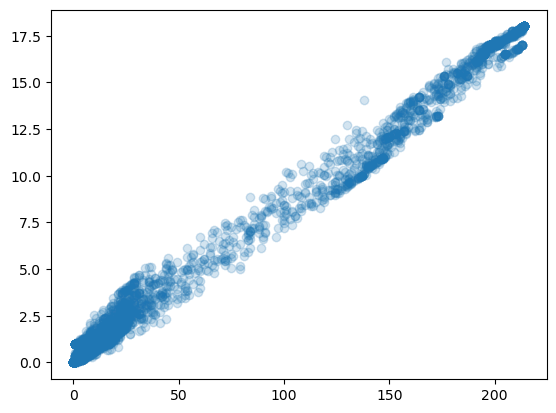

In [30]:
plt.scatter(x.drop('C', axis=1), y.drop('C', axis=1), alpha=0.1)

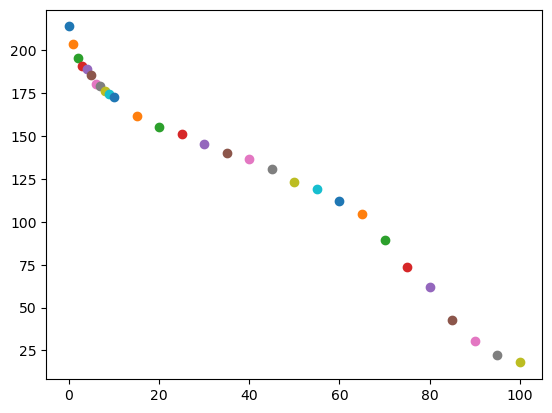

3      191.000000
4      193.333333
5      193.333333
6      193.333333
7      195.333333
          ...    
253    168.833333
254    163.833333
255    157.333333
256    154.333333
110    156.000000
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


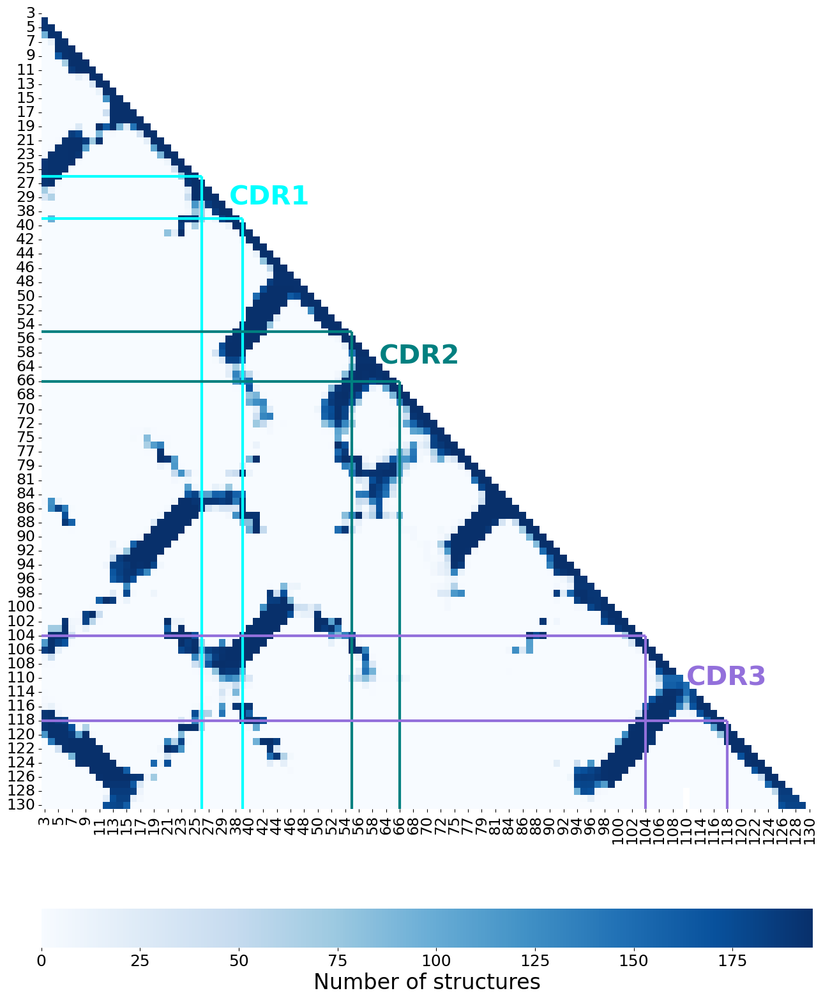

113


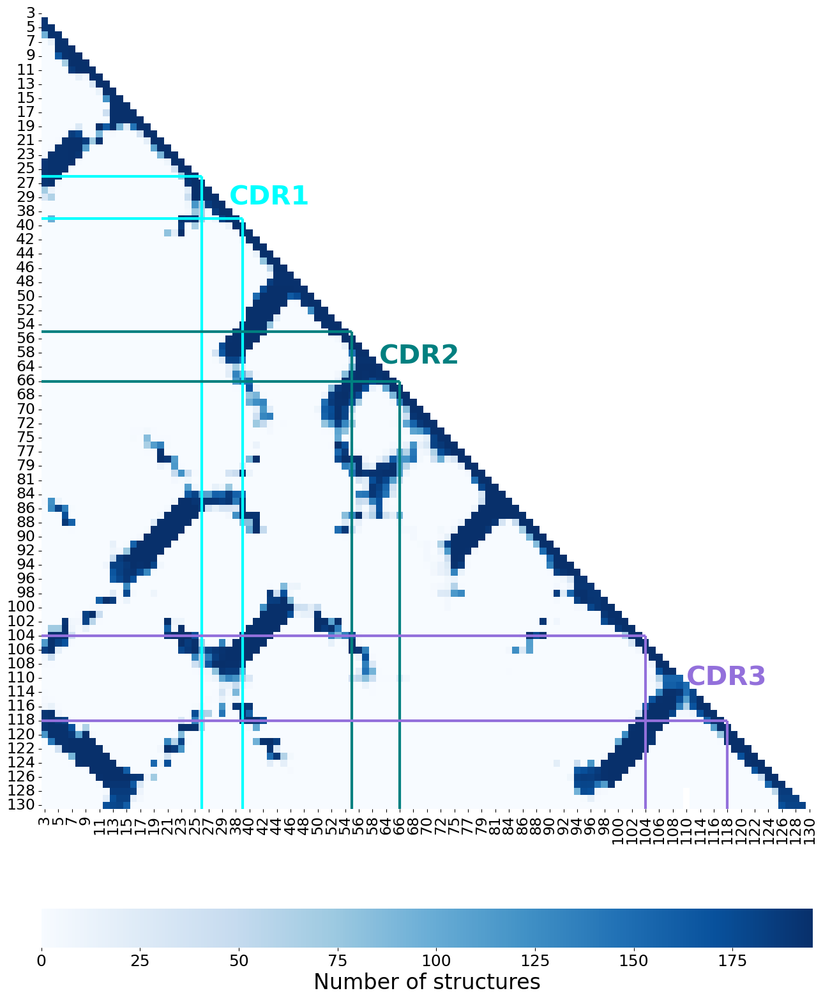

3      168.750000
4      171.083333
5      171.083333
6      171.083333
7      173.083333
          ...    
253    152.666667
254    147.666667
255    142.000000
256    139.000000
110    141.833333
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


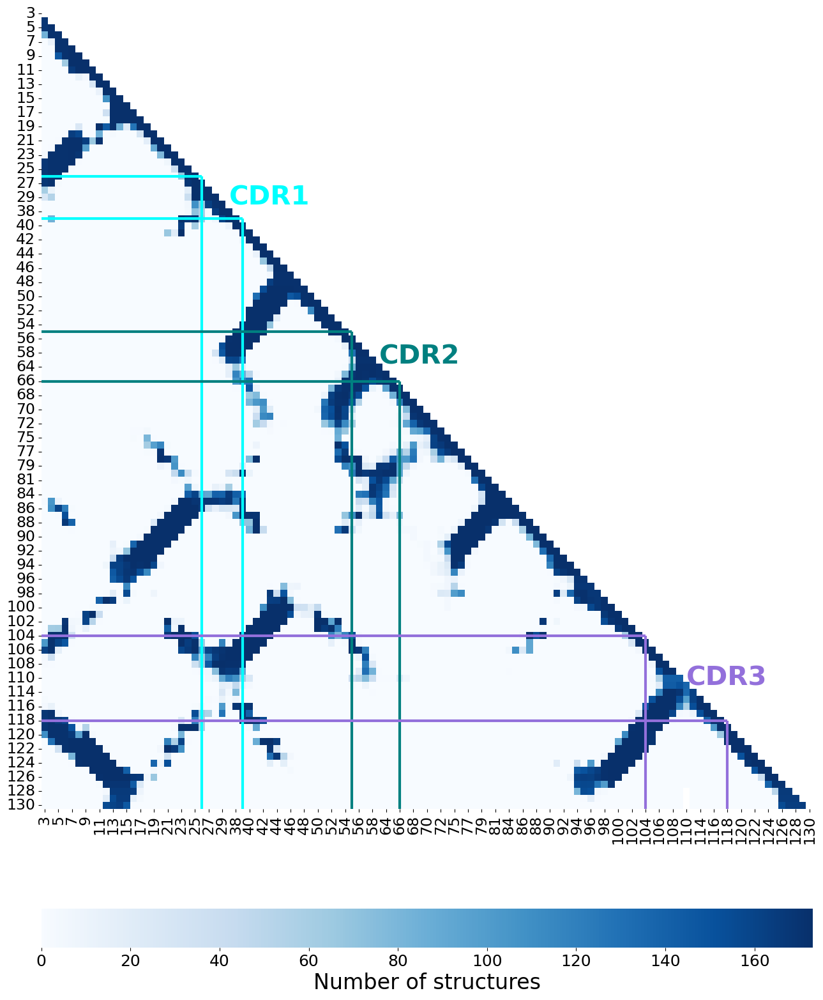

113


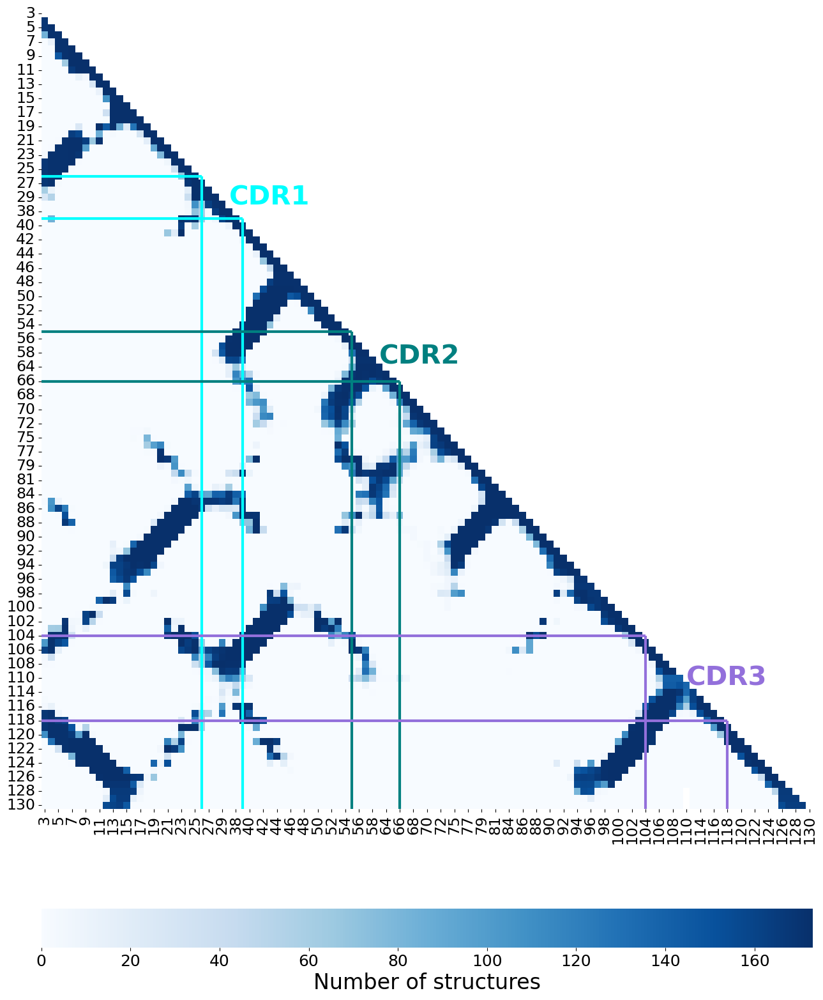

3      157.233333
4      159.566667
5      159.566667
6      159.566667
7      161.566667
          ...    
253    142.900000
254    137.900000
255    133.316667
256    130.316667
110    130.566667
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


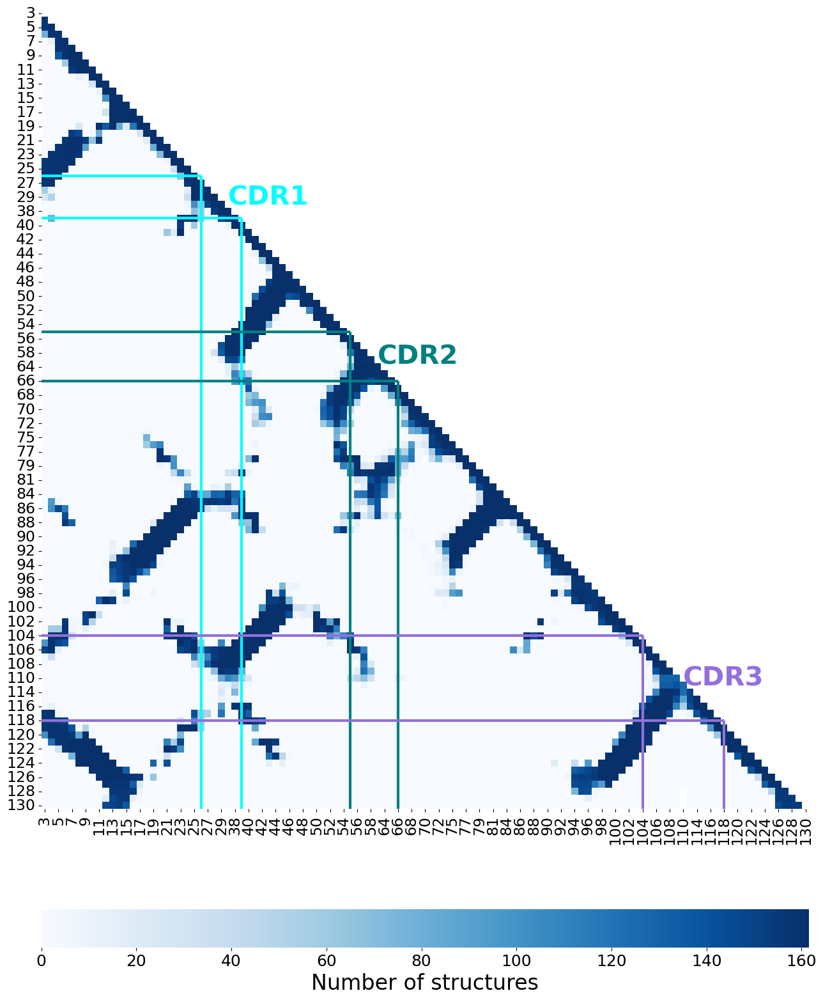

113


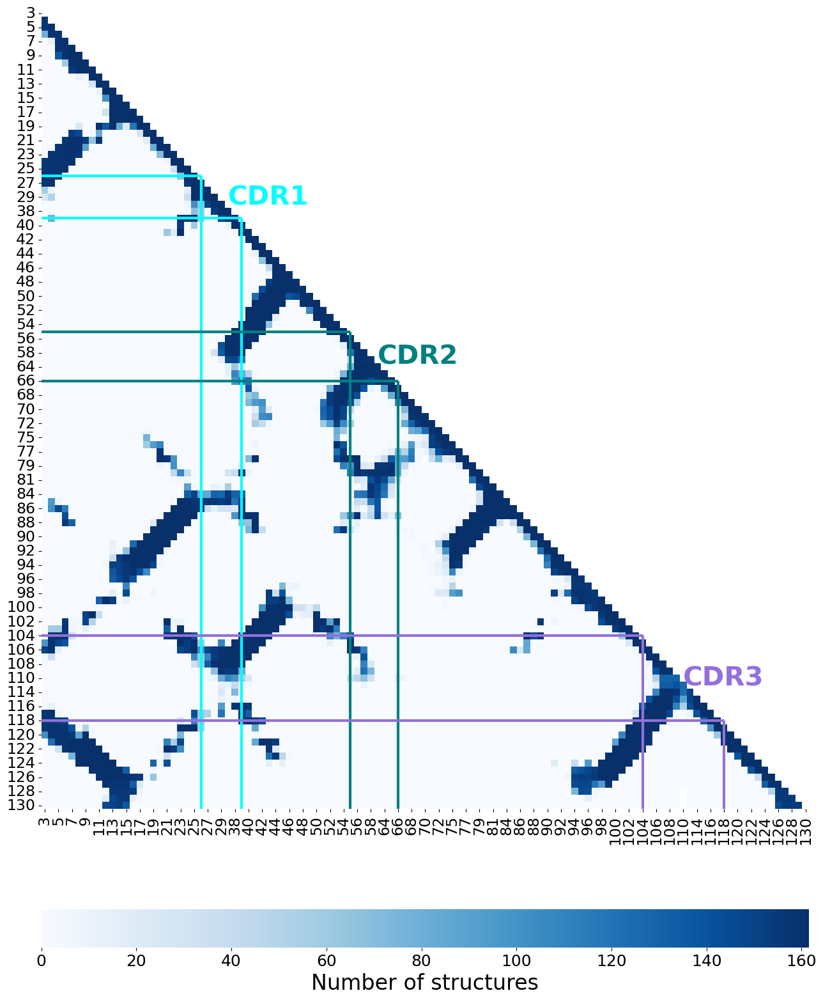

3      119.766667
4      121.433333
5      121.433333
6      121.433333
7      123.433333
          ...    
253    109.171429
254    105.504762
255    101.719048
256     99.576190
110    100.340476
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


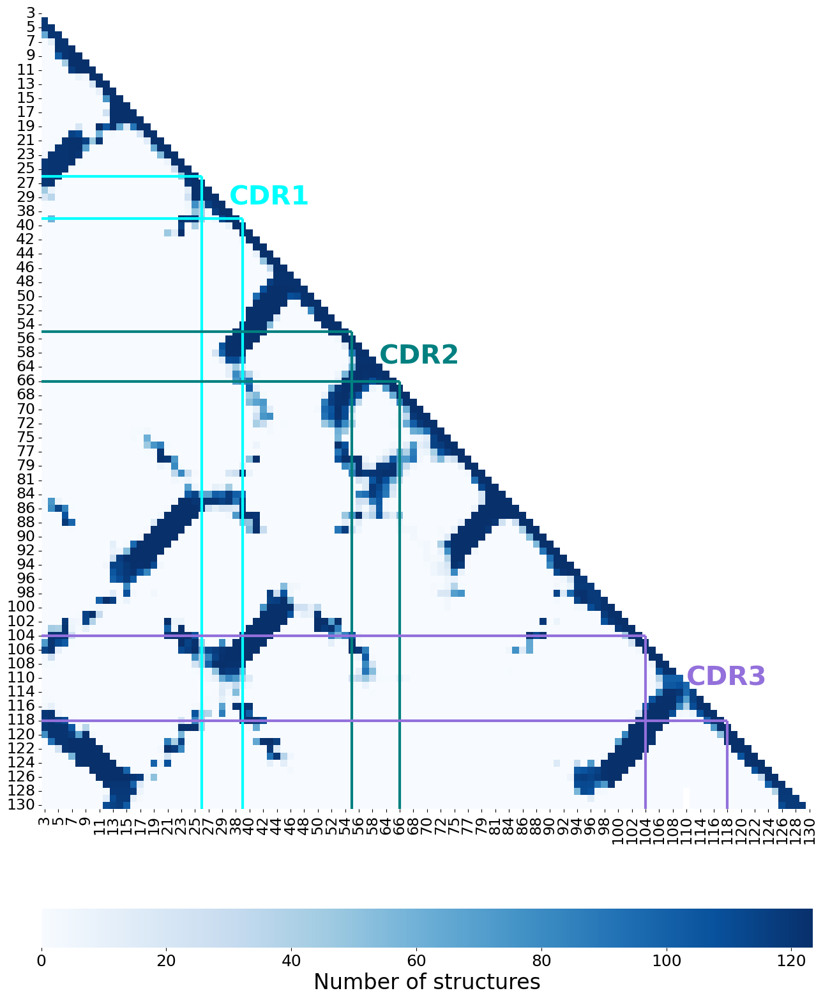

113


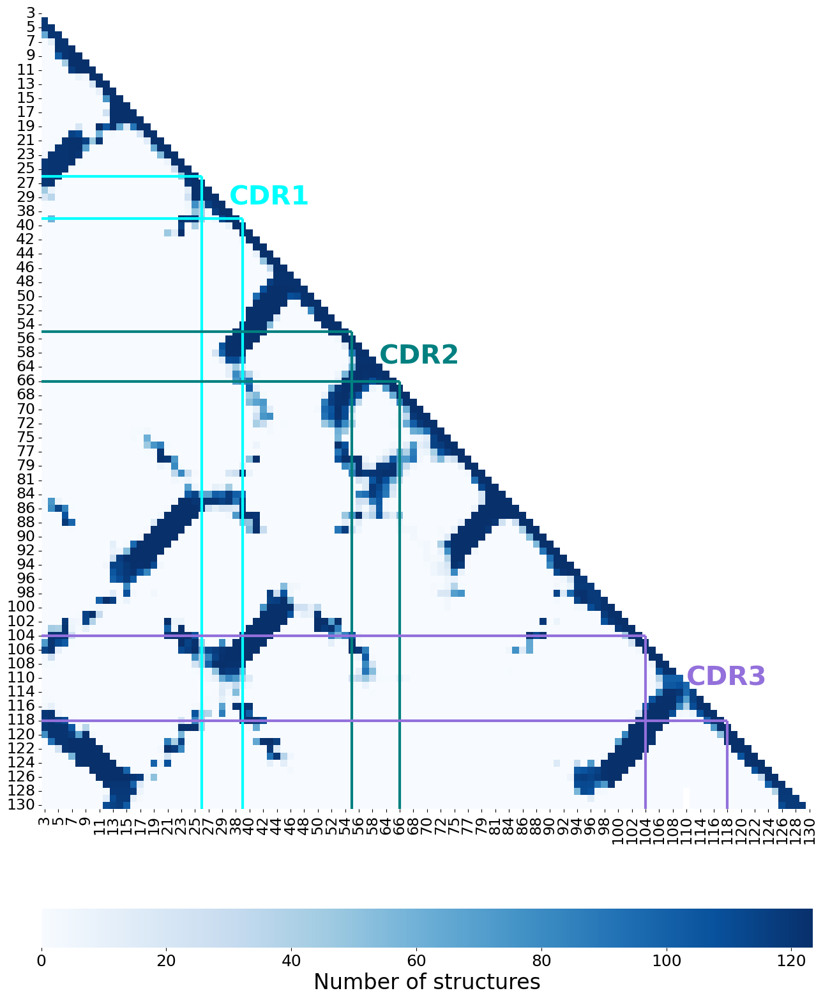

3      71.387092
4      72.253759
5      72.253759
6      72.253759
7      73.753759
         ...    
253    63.411551
254    60.728217
255    58.343131
256    56.303131
110    60.609224
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


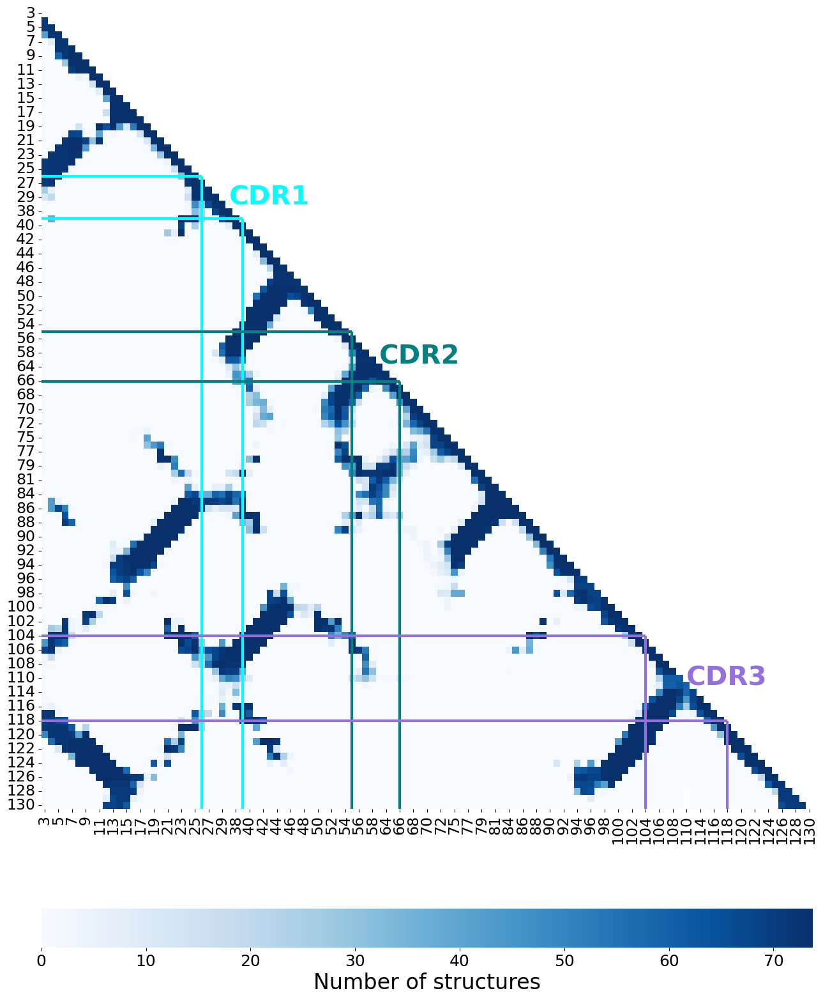

113


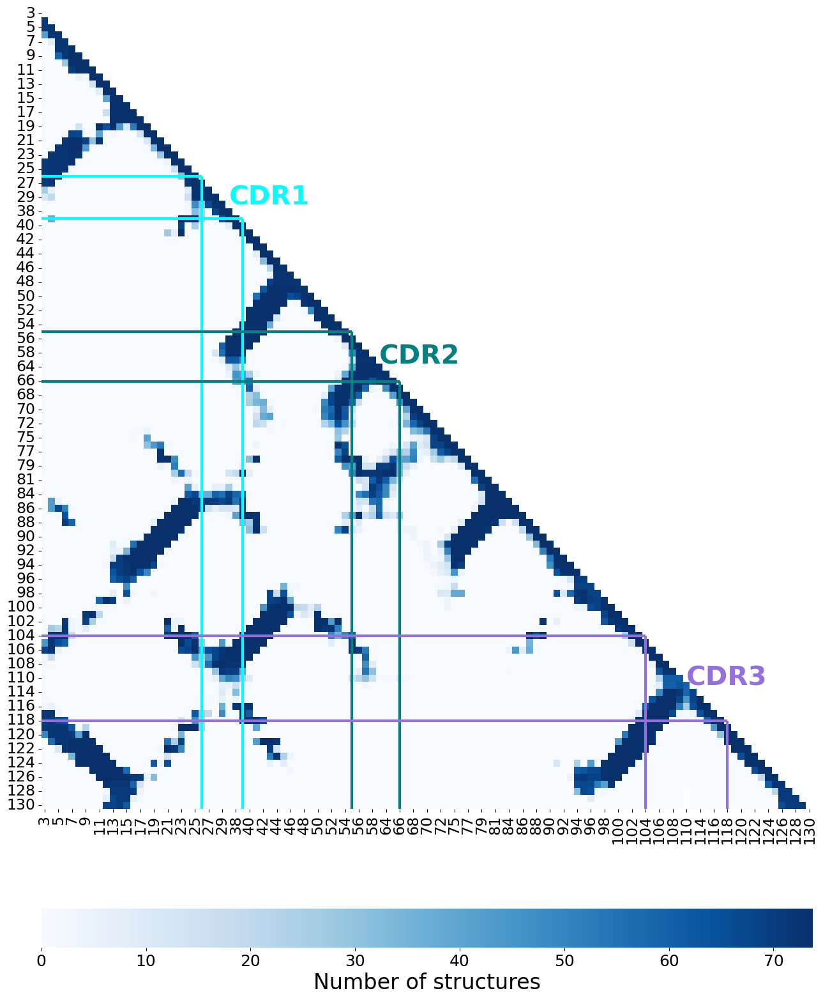

3      16.635018
4      16.898546
5      16.898546
6      16.898546
7      17.998546
         ...    
253    15.040092
254    14.317215
255    13.516143
256    13.333643
110    14.627207
Length: 239, dtype: float64
3      209.0
4      212.0
5      212.0
6      212.0
7      214.0
       ...  
254    182.0
255    174.0
256    171.0
110    169.0
C      268.0
Length: 240, dtype: float64
113


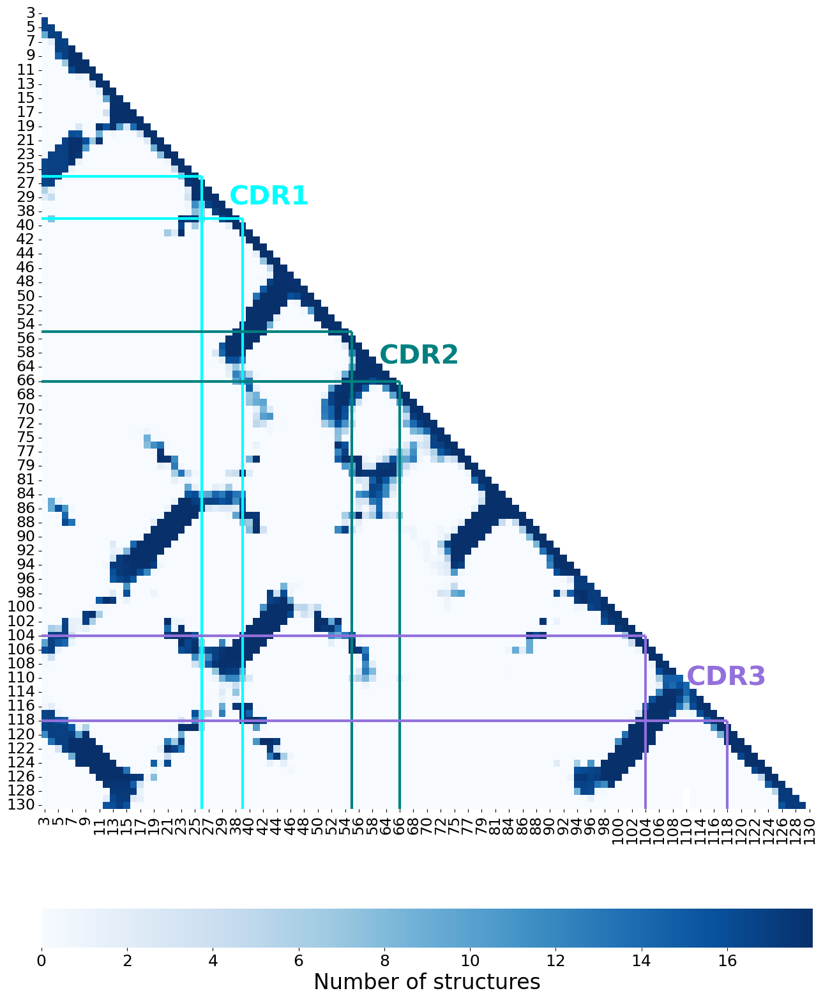

113


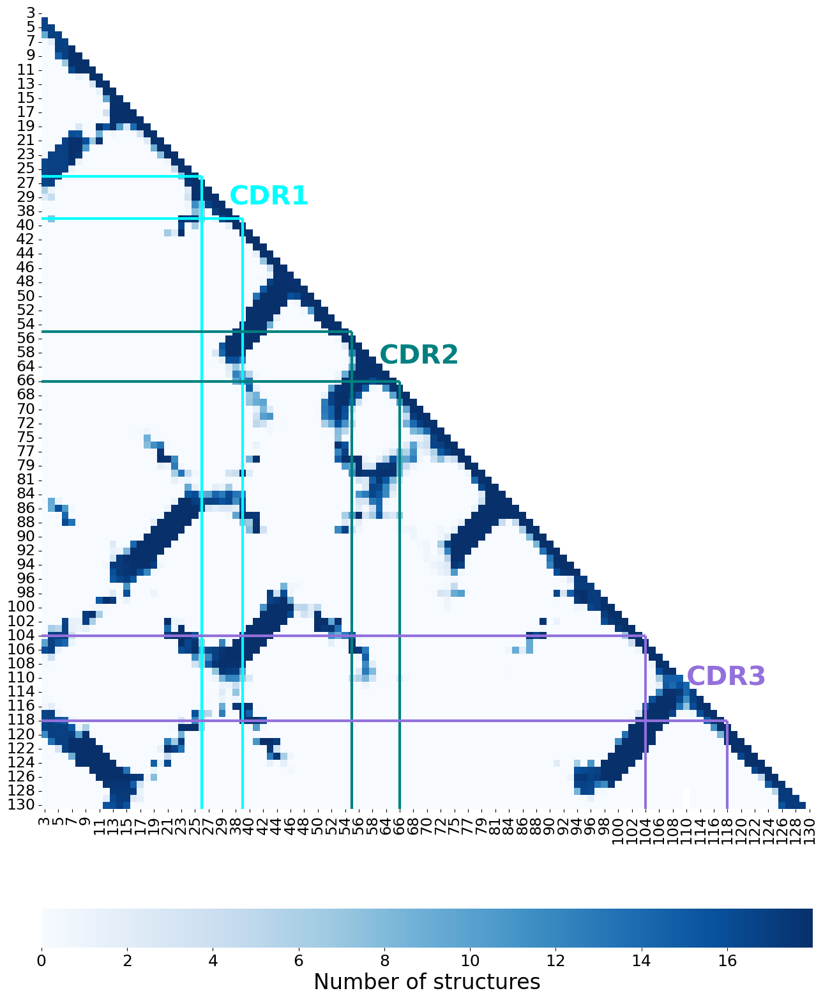

In [31]:
#Now add a heatmap where I look using the structure weights

ax = plt.subplot()
for d in [0,1,2,3,4,5,6,7,8,9,10,15,20,25,30,35,40,45,50,55,60,65,70,75,80,85,90,95,100]:
    weigth_vector = [1/np.sum(ab_dists[i] <= d) for i in range(ab_dists.shape[0])]
    ax.scatter(d, sum(weigth_vector))
plt.show()

x = count_b

for d in [2,10,15,50,75,100]:
    contacts = (d0_b <= 10).astype(int).T
    weigth_vector = [1/np.sum(ab_dists[i] <= d) for i in range(ab_dists.shape[0])]
    contacts_weighted = contacts.mul(weigth_vector, axis=0).sum().unstack()
    if d == 100:
        y = contacts_weighted
    print(contacts_weighted.max())
    print(count_b.max())

    plot_heatmap(sort_distance_df(contacts_weighted), vmin=0, vmax=sum(weigth_vector),cmap='Blues',
                clabel = 'Number of structures',
                save='yes', myoutput= f1 + 'effective_countB_withinchain_'+str(d)+'.png')

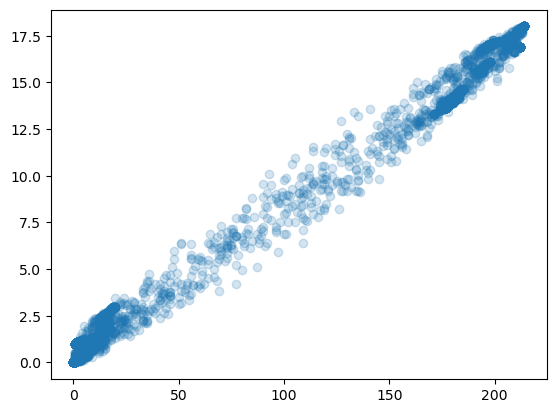

In [32]:
plt.scatter(x.drop('C', axis=1), y.drop('C', axis=1), alpha=0.1)